In [11]:
import os
import cv2
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from pathlib import Path
# !pip install ultralytics
from ultralytics import YOLO
import numpy as np
import matplotlib.pyplot as plt
# !pip install easyocr
import easyocr
import json
from tqdm import tqdm
import seaborn as sns
import pandas as pd
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
#! pip install python-Levenshtein
import Levenshtein


In [44]:
# Només caràcters presents en matrícules espanyoles (sense vocals, per la confusió OCR)
CHAR_CLASSES = "0123456789BCDFGHJKLMNPQRSTVWXYZ"

class LicensePlateDetector:
    def __init__(self):
        self.device = "cuda" if torch.cuda.is_available() else "cpu" 
        self.model = None

    # =========================================================================
    # Funcions OCR
    # =========================================================================
    
    def correct_to_digit(self, char):
        """Intenta corregir caràcters amb confusió a dígits (per posicions 0-3)."""
        confusion_map = {'O': '0', 'Q': '0', 'I': '1', 'L': '1', 'S': '5', 'Z': '2', 'B': '8'}
        if char.isdigit():
            return char
        return confusion_map.get(char.upper(), char)

    def correct_to_letter(self, char):
        """Intenta corregir caràcters amb confusió a lletres (per posicions 4-6)."""
        confusion_map = {'0': 'D', '1': 'L', '5': 'S', '8': 'B', '2': 'Z', 'H': 'M', '6': 'G'}
        if char.isalpha():
            return char
        return confusion_map.get(char, char)
    
    def calculate_confidence_full(self, ocr_raw_full):
        """Calcula la confiança mitjana dels resultats OCR de la placa sencera."""
        if not ocr_raw_full:
            return 0.0
        confidences = [item[2] for item in ocr_raw_full]
        return np.mean(confidences) if confidences else 0.0

    # =========================================================================
    # Funcions de Format i Filtres
    # =========================================================================

    def calculate_format_score(self, plate_segment):
        """
        Calcula l'Score basant-se en el format 4 Dígits + 3 Lletres.
        (S'assumeix que el 'plate_segment' ja ha estat corregit pel format.)
        """
        current_score = 0
        if len(plate_segment) != 7:
            return -1 
        for k, char in enumerate(plate_segment):
            is_digit = char.isdigit()
            is_letter = char.isalpha()
            if k < 4 and is_digit: 
                current_score += 1
            elif k >= 4 and is_letter:
                current_score += 1
        return current_score
        
    def apply_final_correction(self, plate_segment):
        """Força el format 4 dígits + 3 lletres, corregint confusions habituals."""
        final_placa = []
        segment = plate_segment[:7] if len(plate_segment) > 7 else plate_segment
        for k, char in enumerate(segment):
            if k < 4:
                final_placa.append(self.correct_to_digit(char))
            else:
                final_placa.append(self.correct_to_letter(char))
        return "".join(final_placa)
    
    def find_best_7_char_segment(self, filtered_text):
        """
        Troba el millor segment de 7 caràcters. Aplica la correcció de format
        *abans* de calcular l'Score per solucionar problemes.
        """
        best_plate_corrected = ""
        max_score = -1
        
        if len(filtered_text) >= 7:
            for start_idx in range(len(filtered_text) - 6):
                current_segment_raw = filtered_text[start_idx : start_idx + 7]
                
                # CLAU: Apliquem la correcció de format abans de puntuar
                current_segment_corrected = self.apply_final_correction(current_segment_raw)
                
                current_score = self.calculate_format_score(current_segment_corrected)
                
                if current_score > max_score:
                    max_score = current_score
                    best_plate_corrected = current_segment_corrected 
        
        return best_plate_corrected, max_score
        
    def find_best_7_char_segment(self, filtered_text):
        best_plate_corrected = ""
        max_score = -1
        
        if len(filtered_text) >= 7:
            for start_idx in range(len(filtered_text) - 6):
                current_segment_raw = filtered_text[start_idx : start_idx + 7]
                current_segment_corrected = self.apply_final_correction(current_segment_raw)
                current_score = self.calculate_format_score(current_segment_corrected)
                
                if current_score > max_score:
                    max_score = current_score
                    best_plate_corrected = current_segment_corrected 
        
        return best_plate_corrected, max_score
    
    # =========================================================================
    # Funcions de Detecció i Entrenament
    # =========================================================================
    
    def create_dataset(self, dataset_path, yaml_path="dataset.yaml"):
        """Crea un fitxer de configuració per al dataset"""
        train_path = os.path.join(dataset_path, 'images', 'train')
        val_path = os.path.join(dataset_path, 'images', 'val')
        test_path = os.path.join(dataset_path, 'images', 'test')

        config_content = f"""
        path: {dataset_path}
        train: {train_path}
        val: {val_path}
        test: {test_path}
        names:
        0: license_plate"""
        with open(yaml_path, 'w') as file:
            file.write(config_content)
        print(f"Dataset configuration file created at {yaml_path}")
        return yaml_path

    def train_model(self, dataset_path, epochs=10, batch=8, project="license_plate_training"):
        """Entrena un model YOLOv8 per a la detecció de matrícules"""
        yaml_path = self.create_dataset(dataset_path)
        
        print("Starting training...")

        # Load base model
        self.model = YOLO("yolov8n.pt")
        # Train the model on the custom dataset
        results = self.model.train(data=yaml_path, epochs=epochs, batch=batch, project=project)
        best_model_path = Path(results.save_dir) / "weights" / "best.pt"
        
        print("Training completed")
        print(f"Best model saved at: {str(best_model_path)}")
        return str(best_model_path)

    def detect_license_plate(self, best_model_path, test_dir, output_dir, conf=0.25):
        """Detect license plates in images using the trained model."""
        self.model = YOLO(best_model_path) 
        print(f"Detecting license plates with model {best_model_path}")
        
        prediction_results = self.model.predict(source=test_dir, save=False, conf=conf)
        
        return prediction_results
        
    # =========================================================================
    # Funcions de Segmentació de Caràcters
    # =========================================================================
    
    def preprocess_plate_for_segmentation(self, plate_image):
        """Preprocessament per aïllar els caràcters."""
        # Convertir a HSV i utilitzar el canal V
        hsv = cv2.cvtColor(plate_image, cv2.COLOR_BGR2HSV)
        _, _, image_v = cv2.split(hsv)

        # Aplicar soroll gaussià
        image_v = cv2.GaussianBlur(image_v, (5, 5), 0)
        
        # Aplicar Otsu per obtenir imatge binària
        _, binary = cv2.threshold(image_v, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
        
        # Operacions morfològiques per millorar la imatge binària
        # kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
        # # CLOSING: tancar forats dins dels caràcters
        # binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel, iterations=3)
        # #OPENING: eliminar soroll petit i separar caràcters propers
        # binary = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=1)

        return binary

    def segment_characters(self, plate_image):
        """Segmenta caràcters mitjançant Connected Components i corregeix amb Projecció Horizontal si és necessari."""
        preprocessed_plate = self.preprocess_plate_for_segmentation(plate_image) 
        plate_height, plate_width = preprocessed_plate.shape
        
        EXPANSION_FACTOR = 0.04 
        eu_zone_width = int(plate_width * 0.05)
        
        num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(preprocessed_plate, connectivity=8)
        
        characters = []
        for i in range(1, num_labels):
            x_orig = stats[i, cv2.CC_STAT_LEFT]
            y_orig = stats[i, cv2.CC_STAT_TOP]
            w_orig = stats[i, cv2.CC_STAT_WIDTH]
            h_orig = stats[i, cv2.CC_STAT_HEIGHT]
            area = stats[i, cv2.CC_STAT_AREA]
            aspect_ratio = w_orig / h_orig if h_orig > 0 else 0
            
            min_char_height = plate_height * 0.25
            max_char_height = plate_height * 0.95
            min_char_width = plate_width * 0.02
            min_area = (min_char_height * min_char_width) * 0.3 
            
            valid_height = min_char_height <= h_orig <= max_char_height
            valid_width = w_orig >= min_char_width
            valid_area = area > min_area
            valid_aspect = 0.05 < aspect_ratio < 2.0
            
            in_eu_zone = x_orig < eu_zone_width
            touches_border = (x_orig == 0 or y_orig == 0 or 
                              (x_orig + w_orig) >= plate_width or (y_orig + h_orig) >= plate_height)

            if (valid_height and valid_width and valid_area and 
                valid_aspect and not touches_border and not in_eu_zone):
                
                expansion_amount = int(h_orig * EXPANSION_FACTOR)
                x_start = max(0, x_orig - expansion_amount)
                y_start = max(0, y_orig - expansion_amount)
                x_end = min(plate_width, x_orig + w_orig + expansion_amount)
                y_end = min(plate_height, y_orig + h_orig + expansion_amount)
                w_exp = x_end - x_start
                h_exp = y_end - y_start
                
                character_roi = plate_image[y_start:y_end, x_start:x_end]
                
                characters.append({
                    'image': character_roi, 
                    'bbox': (x_start, y_start, w_exp, h_exp), 
                    'area': area, 
                    'center_x': x_start + w_exp/2
                })
        
        characters.sort(key=lambda c: c['bbox'][0])
        
        if len(characters) < 5:
            print(f"Només {len(characters)} caràcters trobats. Provant projecció horitzontal...")
            characters_proj = self.segment_by_projection(plate_image, preprocessed_plate)
            if len(characters_proj) > len(characters):
                characters = characters_proj
        
        if len(characters) > 7:
            characters = sorted(characters, key=lambda c: c['area'], reverse=True)[:7]
            characters.sort(key=lambda c: c['bbox'][0])
            
        print(f"Segmentació final: {len(characters)} caràcters")
        return characters, preprocessed_plate

    def segment_by_projection(self, plate_image, binary_plate):
        """Mètode alternatiu de segmentació per projecció horitzontal."""
        plate_height, plate_width = binary_plate.shape
        eu_zone_width = int(plate_width * 0.05)
        binary_cropped = binary_plate[:, eu_zone_width:]
        vertical_projection = np.sum(binary_cropped, axis=0)
        threshold = np.max(vertical_projection) * 0.3
        
        in_character = False
        characters = []
        start_x = 0
        
        for x in range(len(vertical_projection)):
            if vertical_projection[x] > threshold and not in_character:
                start_x = x
                in_character = True
            elif vertical_projection[x] <= threshold and in_character:
                end_x = x
                width = end_x - start_x
                
                if width > 5:
                    actual_start_x = start_x + eu_zone_width
                    actual_end_x = end_x + eu_zone_width
                    char_roi = plate_image[0:plate_height, actual_start_x:actual_end_x]
                    characters.append({
                        'image': char_roi,
                        'bbox': (actual_start_x, 0, width, plate_height),
                        'area': width * plate_height,
                        'center_x': actual_start_x + width/2
                    })
                
                in_character = False
        
        if in_character and (len(vertical_projection) - start_x) > 5:
            width = len(vertical_projection) - start_x
            actual_start_x = start_x + eu_zone_width
            char_roi = plate_image[0:plate_height, actual_start_x:]
            characters.append({
                'image': char_roi,
                'bbox': (actual_start_x, 0, width, plate_height),
                'area': width * plate_height,
                'center_x': actual_start_x + width/2
            })
        
        return characters

    # =========================================================================
    # OCR and Unification Functions
    # =========================================================================
    def ocr_segmented_characters_with_conf(self, characters, reader, target_height=64, spacing=5):
        """Uneix els 7 caràcters segmentats i aplica OCR."""
        if len(characters) != 7:
            return "", 0.0
        
        processed_chars = []
        max_height = target_height 
        
        for char_info in characters:
            char_img = char_info['image']
            h_orig, w_orig = char_img.shape[:2]
            w_new = int(w_orig * (max_height / h_orig))
            resized_char = cv2.resize(char_img, (w_new, max_height), interpolation=cv2.INTER_LINEAR)
            processed_chars.append(resized_char)

        total_width = sum(c.shape[1] for c in processed_chars) + spacing * (len(processed_chars) - 1)
        max_height_padded = processed_chars[0].shape[0] 
        unified_image_bgr = np.ones((max_height_padded, total_width, 3), dtype=np.uint8) * 255 
        
        current_x = 0
        for char_img in processed_chars:
            h, w, _ = char_img.shape
            unified_image_bgr[:, current_x : current_x + w] = char_img  
            current_x += w + spacing

        # V I S U A L I T Z A C I Ó 
        #plt.figure(figsize=(10, 1.5))
        #plt.imshow(cv2.cvtColor(unified_image_bgr, cv2.COLOR_BGR2RGB)) 
        #plt.title("Visualització: Caràcters Segmentats i Units")
        #plt.axis('off')
        #plt.show()
        
        gray_unified = cv2.cvtColor(unified_image_bgr, cv2.COLOR_BGR2GRAY)
        _, ocr_input_image = cv2.threshold(gray_unified, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        
        ocr_results_list = reader.readtext(ocr_input_image, detail=1, paragraph=False, allowlist=CHAR_CLASSES)
        
        if ocr_results_list:
            best_result = max(ocr_results_list, key=lambda item: item[2])
            bbox, result_text, confidence = best_result
            filtered_result = str(result_text).replace(" ", "").upper()
            filtered_result = "".join([c for c in filtered_result if c in CHAR_CLASSES])
            return filtered_result, float(confidence)
        else:
            return "", 0.0
            
    # =========================================================================
    # Validació Creuada (Mètode 3) Functions
    # =========================================================================

    def ocr_individual_characters(self, characters, reader):
        """
        Executa l'OCR sobre els 7 caràcters individuals.
        Retorna una llista de [text_predicció, confiança] per a cadascun.
        """
        if len(characters) != 7:
            return []
            
        individual_results = []
        
        for char_info in characters:
            char_img = char_info['image']
            
            ocr_results = reader.readtext(
                char_img, 
                detail=1, 
                paragraph=False, 
                allowlist=CHAR_CLASSES,
                height_ths=0.2 
            )
            
            if ocr_results:
                best_text = ocr_results[0][1]
                best_conf = ocr_results[0][2]
            else:
                best_text = ""
                best_conf = 0.0
            
            individual_results.append({
                'text': best_text.replace(" ", "").upper()[:1], 
                'confidence': best_conf
            })
            
        return individual_results

    def validate_with_individual_conf(self, final_text, individual_results):
        """
        Mètode 3: Calcula una nova puntuació de confiança basada en la coincidència 
        del 'final_text' (Candidat A o B) amb l'OCR de cada caràcter individual.
        """
        if len(final_text) != 7 or len(individual_results) != 7:
            return 0.0 # Error en el format

        weighted_confidence_sum = 0
        
        for k in range(7):
            predicted_char = individual_results[k]['text']
            predicted_conf = individual_results[k]['confidence']
            target_char = final_text[k]

            weight = 0.0
            
            # 1. Coincidència Perfecta
            if target_char == predicted_char:
                weight = 1.0
            
            # 2. Correcció de Confusió (Dígits 0-3)
            elif k < 4 and self.correct_to_digit(predicted_char) == target_char and target_char.isdigit():
                weight = 0.9 

            # 3. Correcció de Confusió (Lletres 4-6)
            elif k >= 4 and self.correct_to_letter(predicted_char) == target_char and target_char.isalpha():
                weight = 0.9

            weighted_confidence_sum += predicted_conf * weight
            
        validation_score = weighted_confidence_sum / 7.0
        return validation_score

    # Dins de la classe LicensePlateDetector
    def build_plate_from_individual_ocr(self, individual_results):
        """
        Mètode 4: Construeix la matrícula caràcter per caràcter, forçant el format 4D+3L 
        aplicant les correccions de confusió (O->0, 0->D, etc.) a cada posició.
        Retorna (placa_fusionada, score_format).
        """
        if len(individual_results) != 7:
            return "", -1
        
        fusion_placa = []
        
        for k in range(7):
            predicted_char_raw = individual_results[k]['text']
            
            if k < 4:
                # Caràcter 0-3: Forçar a Dígit
                corrected_char = self.correct_to_digit(predicted_char_raw)
            else:
                # Caràcter 4-6: Forçar a Lletra
                corrected_char = self.correct_to_letter(predicted_char_raw)
                
            # Si la correcció va canviar el caràcter, és perquè hi havia confusió 
            # (Exemple: 'O' detectat -> '0' corregit) o era directament el correcte.
            # Si no es va corregir res, s'utilitza l'original corregit si no és buit.
            if corrected_char:
                fusion_placa.append(corrected_char)
            elif predicted_char_raw:
                 # Cas extrem: si la correcció no va actuar, mantenim la predicció simple (Ex: 'X')
                 fusion_placa.append(predicted_char_raw) 
            else:
                # En cas de predicció buida (confiança zero o error)
                fusion_placa.append("_") 
                
        final_plate_text = "".join(fusion_placa)
        format_score = self.calculate_format_score(final_plate_text)

        # Si el text fusionat té 7 caràcters, calculem la seva confiança creuada
        if len(final_plate_text) == 7:
             val_conf = self.validate_with_individual_conf(final_plate_text, individual_results)
        else:
             val_conf = 0.0

        return final_plate_text, format_score, val_conf
    
    def mix_plates_by_position(self, text_a, text_b, individual_results, fused_text=None):
        """
        Fusiona A i B caràcter per caràcter, incorporant Fusionat (C) amb lògica de coincidència.
        - Si A i B coincideixen → es manté.
        - Si discrepen → prioritat:
            1 Fusionat (C) si és vàlid i coincideix amb A o B.
            2 Fusionat (C) si és vàlid i coherent amb la posició.
            3 OCR individual si coincideix amb A o B.
            4 Caràcter més coherent amb el format esperat (dígit/lletra).
        """
        if len(text_a) != 7 or len(text_b) != 7:
            return text_a, 0.0

        mixed = []
        confs = []

        for i in range(7):
            char_a = text_a[i]
            char_b = text_b[i]
            char_ind = individual_results[i]['text'] if i < len(individual_results) else ""
            conf_ind = individual_results[i]['confidence'] if i < len(individual_results) else 0.0
            char_fused = fused_text[i] if fused_text and i < len(fused_text) else ""

            # Si A i B coincideixen, el mantenim directament
            if char_a == char_b:
                mixed.append(char_a)
                confs.append(conf_ind)
                continue

            chosen = None

            # 1 Fusionat coincideix amb A o B
            if char_fused and char_fused in CHAR_CLASSES and (char_fused == char_a or char_fused == char_b):
                chosen = char_fused

            # 2 Fusionat vàlid i coherent amb la posició
            elif char_fused and char_fused in CHAR_CLASSES:
                if i < 4 and char_fused.isdigit():
                    chosen = char_fused
                elif i >= 4 and char_fused.isalpha():
                    chosen = char_fused

            # 3 OCR individual coincideix amb A o B
            elif char_ind == char_a:
                chosen = char_a
            elif char_ind == char_b:
                chosen = char_b

            # 4 Format esperat (backup)
            if not chosen:
                if i < 4:
                    chosen = self.correct_to_digit(char_a)
                    if not chosen.isdigit():
                        chosen = self.correct_to_digit(char_b)
                else:
                    chosen = self.correct_to_letter(char_a)
                    if not chosen.isalpha():
                        chosen = self.correct_to_letter(char_b)

            mixed.append(chosen)
            confs.append(conf_ind)

        mixed_plate = "".join(mixed)
        avg_conf = np.mean(confs)
        return mixed_plate, avg_conf

    # =========================================================================
    # Principal Processing Function (AMB NOU DESEMPAT)
    # =========================================================================
    def process_and_show_results(self, prediction_results, reader):
        """
        Processa cada matrícula detectada amb OCR millorat, ara amb lògica 
        de selecció principal basada en Validació Creuada.
        """
        for i, result in enumerate(prediction_results):
            try:
                image = result.orig_img
                boxes = result.boxes
            except AttributeError:
                print("Saltant la processació: resultats invàlids o llibreries no disponibles.")
                return

            if not boxes:
                print(f"\n{'='*60}")
                print(f"  Processant Imatge {i+1}")
                print(f"{'='*60}")
                print(" No s'ha detectat cap matrícula en aquesta imatge.")
                continue

            print(f"\n{'='*60}")
            print(f"  Processant Imatge {i+1}")
            print(f"{'='*60}")

            for j, box in enumerate(boxes):
                if len(boxes) > 1 and j > 0:
                    print(f"{len(boxes)} matrícules detectades. Només es processa la primera.")
                    break

                x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
                plate_image = image[y1:y2, x1:x2]

                if plate_image is None or plate_image.size == 0:
                    print("No s'ha pogut retallar la matrícula.")
                    continue

                print(f"\n Matrícula {j+1}: Bbox ({x1}, {y1}, {x2}, {y2})")

                # 1 Segmentació
                characters, preprocessed_plate = self.segment_characters(plate_image)

                final_plate_text = "ERROR"
                # MAX_SCORE ara es refereix a l'SCORE DE FORMAT (7 màxim)
                max_score = -1 
                # MAX_CONFIDENCE ara es refereix a la Validació Creuada (VAL_CONF)
                max_val_conf = -1.0 

                # 2 LECTURA A: OCR placa sencera
                # ... (Lectura de A: best_plate_full, score_full, conf_full) ...
                ocr_raw_full = reader.readtext(plate_image, detail=1, paragraph=False, allowlist=CHAR_CLASSES)
                sorted_ocr_full = sorted(ocr_raw_full, key=lambda item: item[0][0][0]) if ocr_raw_full else []
                plate_text_raw = "".join([item[1] for item in sorted_ocr_full]).replace(" ", "").upper()
                filtered_full = "".join([c for c in plate_text_raw if c in CHAR_CLASSES])
                if filtered_full.startswith("E"):
                    filtered_full = filtered_full[1:]

                best_plate_full, score_full = self.find_best_7_char_segment(filtered_full)
                conf_full = self.calculate_confidence_full(ocr_raw_full)

                # 3 LECTURA B: OCR segmentada
                corrected_segment_text = ""
                score_segment = -1
                conf_segment = 0.0
                if len(characters) == 7:
                    segmented_text, conf_segment = self.ocr_segmented_characters_with_conf(characters, reader)
                    if len(segmented_text) == 7:
                        corrected_segment_text = self.apply_final_correction(segmented_text)
                        score_segment = self.calculate_format_score(corrected_segment_text)
                        # B ja té Score i Conf

                # ------------------------------------------------------------
                # 2. PAS CLAU: OCR INDIVIDUAL i CÀLCUL DE VALIDACIONS
                # ------------------------------------------------------------
                individual_results = []
                if len(characters) == 7:
                    individual_results = self.ocr_individual_characters(characters, reader)

                val_conf_A = -1.0
                val_conf_B = -1.0
                if individual_results:
                    if best_plate_full:
                        val_conf_A = self.validate_with_individual_conf(best_plate_full, individual_results)
                    if corrected_segment_text:
                        val_conf_B = self.validate_with_individual_conf(corrected_segment_text, individual_results)

                # Mostra resultats A
                if best_plate_full:
                    print(f"  Resultat Placa Sencera (A): {best_plate_full} (Score: {score_full}, Conf: {conf_full:.2f}, Validació: {val_conf_A:.3f})")
                    # A és el primer candidat guanyador
                    final_plate_text = best_plate_full
                    max_score = score_full
                    max_val_conf = val_conf_A
                else:
                    print(" No s'ha obtingut resultat vàlid de la lectura completa (A).")


                # Mostra resultats B
                if corrected_segment_text:
                    print(f"  Resultat Segmentat (B): {corrected_segment_text} (Score: {score_segment}, Conf: {conf_segment:.2f}, Validació: {val_conf_B:.3f})")

                # ------------------------------------------------------------
                # 3. SELECCIÓ REFORÇADA (B vs A)
                # ------------------------------------------------------------
                if corrected_segment_text and final_plate_text != "ERROR":
                    
                    # CRITERI 1: B té Score superior (p. ex., B=7 vs A=6)
                    if score_segment > max_score:
                        final_plate_text = corrected_segment_text
                        max_score = score_segment
                        max_val_conf = val_conf_B
                        print(" Seleccionat (B): Millor Score.")
                        
                    # CRITERI 2: B guanya A, ja que la seva Validació Creuada és molt més alta.
                    # CLAU PER ALS CASOS RARS (Score A=7 enganyós vs Score B=6 fiable)
                    elif max_score == 7 and score_segment >= 6 and val_conf_B > val_conf_A and val_conf_B >= 0.55: # 0.55 és un llindar de fiabilitat
                         if val_conf_B > max_val_conf:
                             final_plate_text = corrected_segment_text
                             max_score = score_segment
                             max_val_conf = val_conf_B
                             print(f" Seleccionat (B): Validació Creuada Alta (B={val_conf_B:.3f}) vs A={val_conf_A:.3f}.")
                             
                    # CRITERI 3: Desempat (Score A == Score B)
                    elif score_segment == max_score:
                        # Prioritzem el que tingui millor Validació Creuada
                        if val_conf_B > max_val_conf:
                            final_plate_text = corrected_segment_text
                            max_val_conf = val_conf_B
                            print(" Seleccionat (B): Millor Validació Creuada (Desempat).")
                        elif val_conf_B == max_val_conf and conf_segment > conf_full:
                            final_plate_text = corrected_segment_text
                            print(" Seleccionat (B): Millor Confiança Bruta (Doble Desempat).")
                        else:
                            print(" Mantingut (A).")
                elif corrected_segment_text:
                    # B és l'únic candidat vàlid si A va fallar
                    final_plate_text = corrected_segment_text
                    max_score = score_segment
                    max_val_conf = val_conf_B
                    
                # ------------------------------------------------------------
                # 4. CANDIDAT C (Fusionat per caràcter) i FUSIÓ A+B (Mix)
                # ------------------------------------------------------------

                corrected_fusion_text = ""
                score_fusion = -1
                val_conf_fusion = 0.0
                if individual_results:
                    corrected_fusion_text, score_fusion, val_conf_fusion = self.build_plate_from_individual_ocr(individual_results)
                    print(f"  Resultat Fusionat (C): {corrected_fusion_text} (Score: {score_fusion}, Validació: {val_conf_fusion:.3f})")
                    
                    # C com a candidat final
                    if score_fusion > max_score or (score_fusion == max_score and val_conf_fusion > max_val_conf):
                        final_plate_text = corrected_fusion_text
                        max_score = score_fusion
                        max_val_conf = val_conf_fusion
                        print(" Seleccionat (C): Millor Fusionat/Validació Confiança.")

                # 5. FUSIÓ A+B (Mix)
                if best_plate_full and corrected_segment_text:
                    fused_text_arg = corrected_fusion_text if corrected_fusion_text else None
                    mixed_plate, mixed_conf = self.mix_plates_by_position(
                        best_plate_full,
                        corrected_segment_text,
                        individual_results,
                        fused_text=fused_text_arg
                    )
                    mixed_score = self.calculate_format_score(mixed_plate)
                    val_conf_mix = self.validate_with_individual_conf(mixed_plate, individual_results)
                    print(f" Fusió A+B (Mix): {mixed_plate} (Score: {mixed_score}, Validació: {val_conf_mix:.3f})")

                    # El Mix només guanya si té un Score igual o superior i una Validació Millor
                    if mixed_score > max_score or (mixed_score == max_score and val_conf_mix > max_val_conf):
                        final_plate_text = mixed_plate
                        max_score = mixed_score
                        max_val_conf = val_conf_mix
                        print(" Seleccionat (Mix A+B): Millor combinació validada.")

                # 6. Final: formatació i visualització
                # ... (La resta de la funció es manté igual per a la sortida) ...
                if not final_plate_text or final_plate_text == "ERROR":
                    final_plate_text = "ERROR"

                if len(final_plate_text.replace(" ", "")) == 7:
                    plate_text = final_plate_text[:4] + " " + final_plate_text[4:]
                else:
                    plate_text = final_plate_text

                print(f"\n OCR Resultat FINAL: {plate_text}")

                # 7. Visualització (igual que abans)
                output_image = plate_image.copy()
                for char_info in characters:
                    x, y, w, h = char_info['bbox']
                    cv2.rectangle(output_image, (x, y), (x + w, y + h), (0, 255, 0), 2)

                # Dibuixa el requadre de la matrícula detectada
                cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 3)  # Blau i més gruixut

                cv2.putText(image, plate_text, (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)

                annotated_full_image = image
                preprocessed_plate_color = cv2.cvtColor(preprocessed_plate, cv2.COLOR_GRAY2BGR) if len(preprocessed_plate.shape) == 2 else preprocessed_plate

                plt.figure(figsize=(20, 5))
                plt.subplot(1, 4, 1)
                plt.imshow(cv2.cvtColor(annotated_full_image, cv2.COLOR_BGR2RGB))
                plt.title("Detection + Final OCR")
                plt.axis('off')

                plt.subplot(1, 4, 2)
                plt.imshow(cv2.cvtColor(plate_image, cv2.COLOR_BGR2RGB))
                plt.title("Cropped Plate")
                plt.axis('off')

                plt.subplot(1, 4, 3)
                plt.imshow(preprocessed_plate, cmap='gray')
                plt.title("Binarized Image (for Segmentation)")
                plt.axis('off')

                plt.subplot(1, 4, 4)
                plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))
                plt.title(f"Characters Segmented: {len(characters)}")
                plt.axis('off')

                plt.suptitle(f"Image {i+1} | FINAL PLATE: {plate_text}")
                plt.tight_layout()
                plt.show()


In [45]:
#* ================= MAIN EXECUTION =================
repo_root = os.getcwd()
dataset_path = os.path.join(repo_root, "BD_LicensePlate")
test_dir = os.path.join(dataset_path, "images", "test")
output_dir = os.path.join(repo_root, "test_results")
best_model_path = os.path.join(repo_root, "models", "best_license_plate.pt")


detector = LicensePlateDetector()
reader = easyocr.Reader(['en'])

#! Uncomment to train if needed
# best_model_path = detector.train_model(dataset_path, epochs=10, batch=8)

prediction_results = detector.detect_license_plate(best_model_path, test_dir, output_dir, conf=0.25)

Neither CUDA nor MPS are available - defaulting to CPU. Note: This module is much faster with a GPU.


Detecting license plates with model c:\Users\adria\OneDrive - UAB\4 ENGINY\Processament Imatge i Video\Repte Matriculas\License-Plate-Detection\models\best_license_plate.pt

image 1/50 c:\Users\adria\OneDrive - UAB\4 ENGINY\Processament Imatge i Video\Repte Matriculas\License-Plate-Detection\BD_LicensePlate\images\test\1.jpg: 384x640 1 license_plate, 207.2ms
image 2/50 c:\Users\adria\OneDrive - UAB\4 ENGINY\Processament Imatge i Video\Repte Matriculas\License-Plate-Detection\BD_LicensePlate\images\test\10.jpg: 384x640 1 license_plate, 65.6ms
image 3/50 c:\Users\adria\OneDrive - UAB\4 ENGINY\Processament Imatge i Video\Repte Matriculas\License-Plate-Detection\BD_LicensePlate\images\test\11.jpg: 384x640 1 license_plate, 67.7ms
image 4/50 c:\Users\adria\OneDrive - UAB\4 ENGINY\Processament Imatge i Video\Repte Matriculas\License-Plate-Detection\BD_LicensePlate\images\test\12.jpg: 384x640 1 license_plate, 66.9ms
image 5/50 c:\Users\adria\OneDrive - UAB\4 ENGINY\Processament Imatge i Video\


  Processant Imatge 1

 Matrícula 1: Bbox (522, 383, 681, 422)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 0478LFR (Score: 7, Conf: 0.96, Validació: 0.000)
  Resultat Segmentat (B): 0478LFR (Score: 7, Conf: 0.37, Validació: 0.000)
 Mantingut (A).
  Resultat Fusionat (C): _______ (Score: 0, Validació: 0.000)
 Fusió A+B (Mix): 0478LFR (Score: 7, Validació: 0.000)

 OCR Resultat FINAL: 0478 LFR


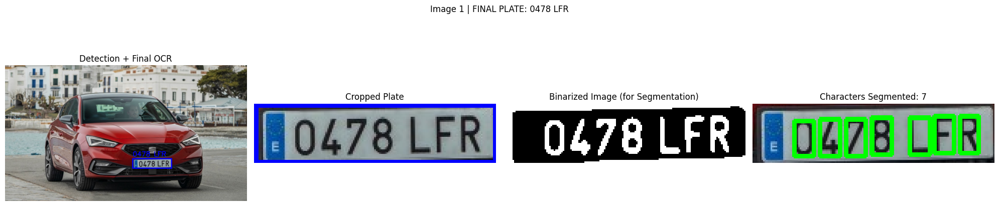


  Processant Imatge 2

 Matrícula 1: Bbox (871, 1057, 1699, 1424)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 5796DKP (Score: 7, Conf: 0.81, Validació: 0.948)
  Resultat Segmentat (B): 5796DKP (Score: 7, Conf: 0.71, Validació: 0.948)
 Mantingut (A).
  Resultat Fusionat (C): 5796DKP (Score: 7, Validació: 0.948)
 Fusió A+B (Mix): 5796DKP (Score: 7, Validació: 0.948)

 OCR Resultat FINAL: 5796 DKP


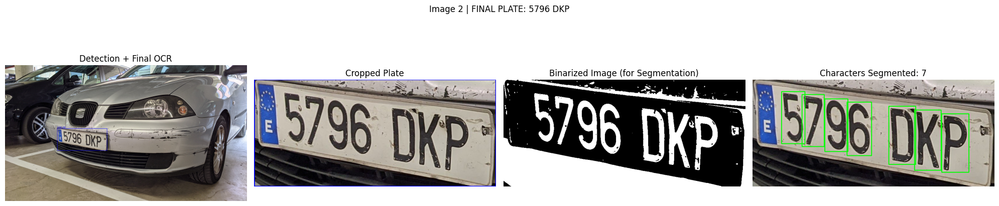


  Processant Imatge 3

 Matrícula 1: Bbox (1009, 870, 1763, 1223)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 1155GGM (Score: 7, Conf: 0.68, Validació: 0.233)
  Resultat Segmentat (B): 1556GMZ (Score: 7, Conf: 0.72, Validació: 0.772)
 Seleccionat (B): Validació Creuada Alta (B=0.772) vs A=0.233.
  Resultat Fusionat (C): _556GMZ (Score: 6, Validació: 0.772)
 Fusió A+B (Mix): 1556GMZ (Score: 7, Validació: 0.772)

 OCR Resultat FINAL: 1556 GMZ


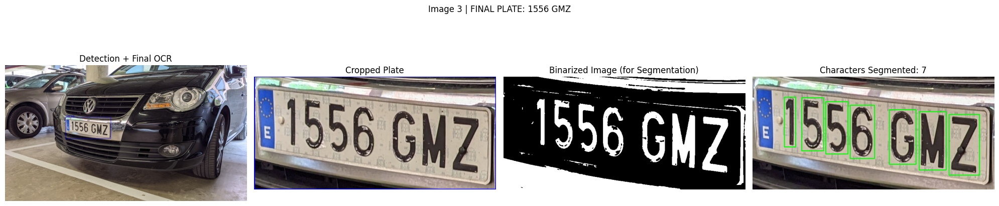


  Processant Imatge 4

 Matrícula 1: Bbox (1074, 955, 1960, 1289)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 6018ZGL (Score: 7, Conf: 0.87, Validació: 0.000)
  Resultat Segmentat (B): 0182GLK (Score: 7, Conf: 1.00, Validació: 0.836)
 Seleccionat (B): Validació Creuada Alta (B=0.836) vs A=0.000.
  Resultat Fusionat (C): 0182G_K (Score: 6, Validació: 0.836)
 Fusió A+B (Mix): 0182GGK (Score: 7, Validació: 0.836)

 OCR Resultat FINAL: 0182 GLK


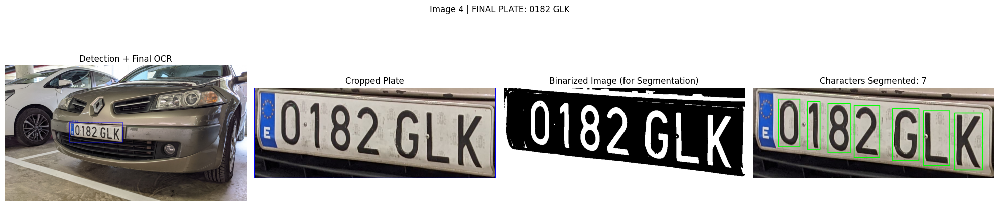


  Processant Imatge 5

 Matrícula 1: Bbox (1196, 709, 2004, 1032)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 8044JMB (Score: 7, Conf: 0.46, Validació: 0.571)
  Resultat Segmentat (B): 3044JMB (Score: 7, Conf: 0.99, Validació: 0.714)
 Seleccionat (B): Validació Creuada Alta (B=0.714) vs A=0.571.
  Resultat Fusionat (C): 3011JMB (Score: 7, Validació: 0.961)
 Seleccionat (C): Millor Fusionat/Validació Confiança.
 Fusió A+B (Mix): 3044JMB (Score: 7, Validació: 0.714)

 OCR Resultat FINAL: 3011 JMB


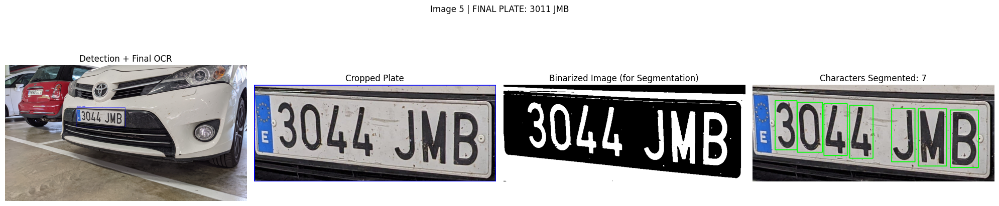


  Processant Imatge 6

 Matrícula 1: Bbox (1099, 927, 1914, 1284)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 5789JHB (Score: 7, Conf: 0.79, Validació: 0.706)
  Resultat Segmentat (B): 5789JHB (Score: 7, Conf: 0.99, Validació: 0.706)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 5_89J_B (Score: 5, Validació: 0.706)
 Fusió A+B (Mix): 5789JHB (Score: 7, Validació: 0.706)

 OCR Resultat FINAL: 5789 JHB


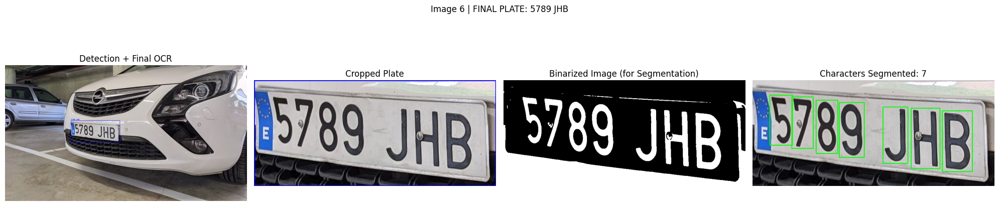


  Processant Imatge 7

 Matrícula 1: Bbox (521, 821, 1450, 1183)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 6929LKK (Score: 7, Conf: 0.68, Validació: 0.857)
  Resultat Segmentat (B): 8929LKK (Score: 7, Conf: 0.81, Validació: 0.714)
 Mantingut (A).
  Resultat Fusionat (C): 6929_KK (Score: 6, Validació: 0.857)
 Fusió A+B (Mix): 6929LKK (Score: 7, Validació: 0.857)

 OCR Resultat FINAL: 6929 LKK


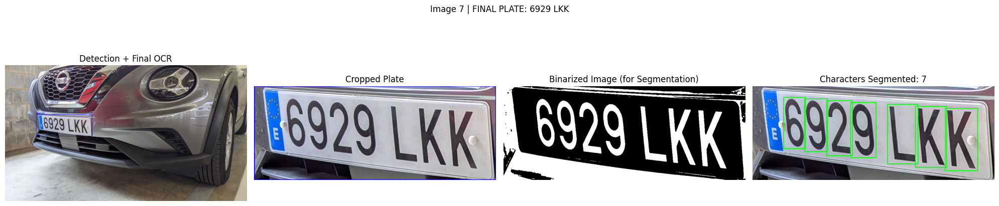


  Processant Imatge 8

 Matrícula 1: Bbox (856, 970, 1905, 1339)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 3660CRT (Score: 7, Conf: 0.58, Validació: 1.000)
  Resultat Segmentat (B): 3660CRT (Score: 7, Conf: 0.99, Validació: 1.000)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 3660CRT (Score: 7, Validació: 1.000)
 Fusió A+B (Mix): 3660CRT (Score: 7, Validació: 1.000)

 OCR Resultat FINAL: 3660 CRT


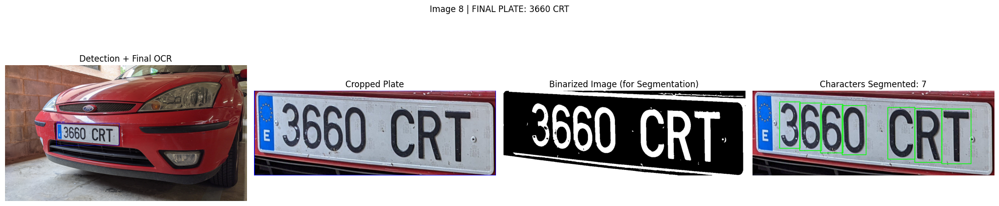


  Processant Imatge 9

 Matrícula 1: Bbox (580, 1069, 1658, 1457)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 6000GVT (Score: 7, Conf: 0.57, Validació: 0.839)
  Resultat Segmentat (B): 6000GVT (Score: 7, Conf: 0.77, Validació: 0.839)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 6000G_T (Score: 6, Validació: 0.839)
 Fusió A+B (Mix): 6000GVT (Score: 7, Validació: 0.839)

 OCR Resultat FINAL: 6000 GVT


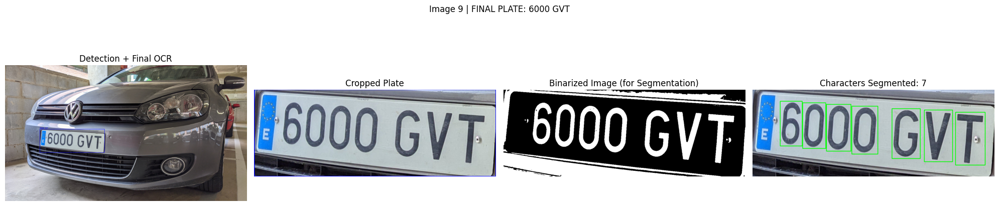


  Processant Imatge 10

 Matrícula 1: Bbox (928, 764, 1898, 1161)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 3587DCY (Score: 7, Conf: 0.73, Validació: 0.837)
  Resultat Segmentat (B): 3587LCX (Score: 7, Conf: 0.89, Validació: 0.839)
 Seleccionat (B): Validació Creuada Alta (B=0.839) vs A=0.837.
  Resultat Fusionat (C): 3587DCX (Score: 7, Validació: 0.979)
 Seleccionat (C): Millor Fusionat/Validació Confiança.
 Fusió A+B (Mix): 3587DCX (Score: 7, Validació: 0.979)

 OCR Resultat FINAL: 3587 DCX


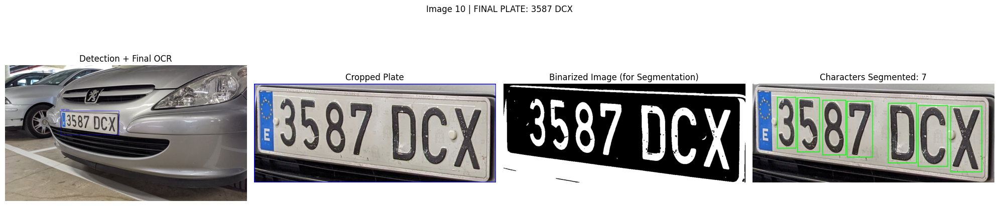


  Processant Imatge 11

 Matrícula 1: Bbox (832, 1023, 1721, 1389)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 1498JBZ (Score: 7, Conf: 0.74, Validació: 0.665)
  Resultat Segmentat (B): 1498JBZ (Score: 7, Conf: 0.74, Validació: 0.665)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): __98JBZ (Score: 5, Validació: 0.665)
 Fusió A+B (Mix): 1498JBZ (Score: 7, Validació: 0.665)

 OCR Resultat FINAL: 1498 JBZ


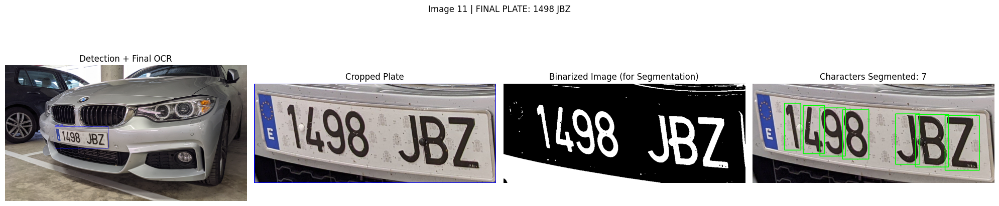


  Processant Imatge 12

 Matrícula 1: Bbox (133, 230, 210, 258)
Segmentació final: 6 caràcters
  Resultat Placa Sencera (A): 8440NSH (Score: 7, Conf: 0.17, Validació: -1.000)

 OCR Resultat FINAL: 8440 NSH


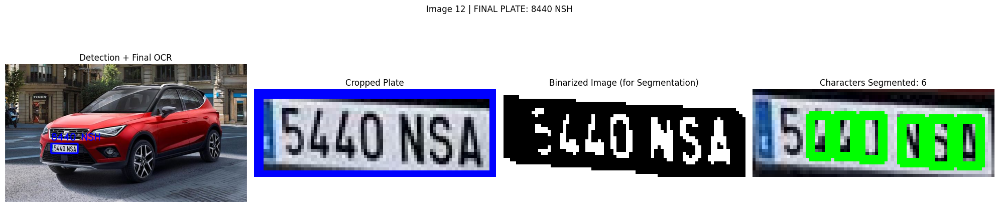


  Processant Imatge 13

 Matrícula 1: Bbox (1204, 851, 2027, 1146)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 2344KJP (Score: 7, Conf: 0.70, Validació: 0.857)
  Resultat Segmentat (B): 2344KJP (Score: 7, Conf: 1.00, Validació: 0.857)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 2341KJP (Score: 7, Validació: 0.984)
 Seleccionat (C): Millor Fusionat/Validació Confiança.
 Fusió A+B (Mix): 2344KJP (Score: 7, Validació: 0.857)

 OCR Resultat FINAL: 2341 KJP


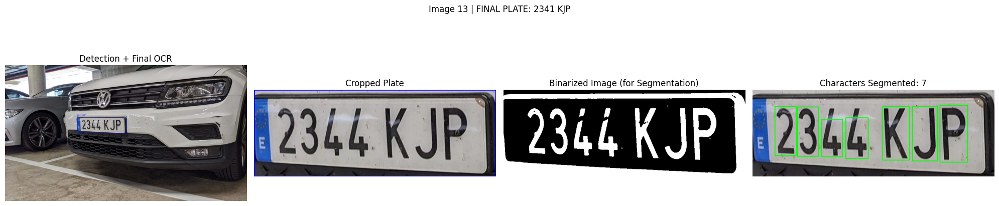


  Processant Imatge 14

 Matrícula 1: Bbox (893, 1212, 1907, 1660)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 0907JRF (Score: 7, Conf: 0.77, Validació: 0.952)
  Resultat Segmentat (B): 0907JRF (Score: 7, Conf: 1.00, Validació: 0.952)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 0907JRF (Score: 7, Validació: 0.952)
 Fusió A+B (Mix): 0907JRF (Score: 7, Validació: 0.952)

 OCR Resultat FINAL: 0907 JRF


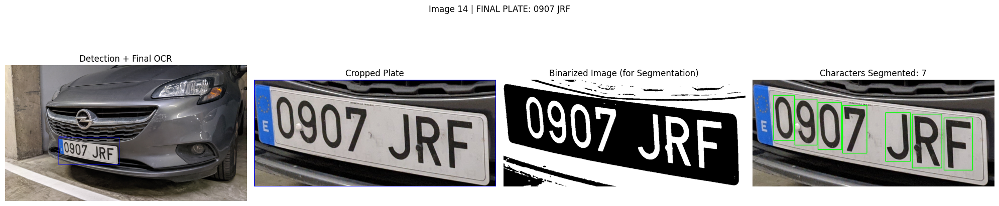


  Processant Imatge 15

 Matrícula 1: Bbox (607, 847, 1605, 1212)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 6554BNX (Score: 7, Conf: 0.60, Validació: 0.854)
  Resultat Segmentat (B): 6554BNX (Score: 7, Conf: 0.99, Validació: 0.854)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 6554BNV (Score: 7, Validació: 0.997)
 Seleccionat (C): Millor Fusionat/Validació Confiança.
 Fusió A+B (Mix): 6554BNX (Score: 7, Validació: 0.854)

 OCR Resultat FINAL: 6554 BNV


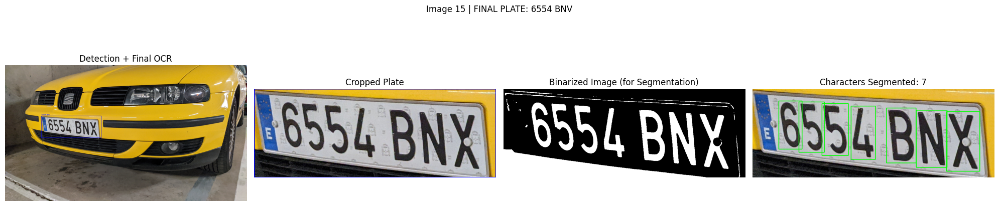


  Processant Imatge 16

 Matrícula 1: Bbox (518, 1120, 1480, 1533)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 6401JBX (Score: 7, Conf: 0.79, Validació: 0.800)
  Resultat Segmentat (B): 8401JBX (Score: 7, Conf: 0.66, Validació: 0.657)
 Mantingut (A).
  Resultat Fusionat (C): 640_JBX (Score: 6, Validació: 0.800)
 Fusió A+B (Mix): 6401JBX (Score: 7, Validació: 0.800)

 OCR Resultat FINAL: 6401 JBX


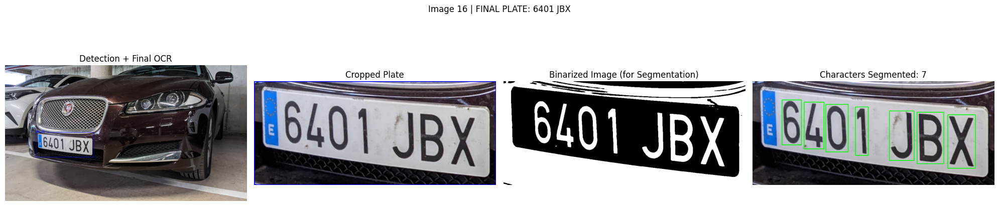


  Processant Imatge 17

 Matrícula 1: Bbox (1223, 1074, 1997, 1399)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 8727JTC (Score: 7, Conf: 0.78, Validació: 0.856)
  Resultat Segmentat (B): 8727JTC (Score: 7, Conf: 0.95, Validació: 0.856)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 8_27JTC (Score: 6, Validació: 0.856)
 Fusió A+B (Mix): 8727JTC (Score: 7, Validació: 0.856)

 OCR Resultat FINAL: 8727 JTC


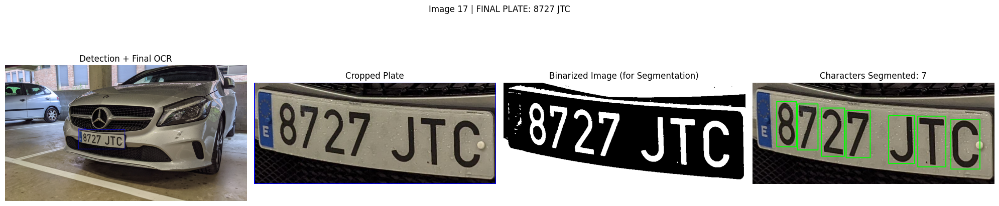


  Processant Imatge 18

 Matrícula 1: Bbox (833, 981, 1728, 1223)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 5275HGY (Score: 7, Conf: 0.55, Validació: 0.959)
  Resultat Segmentat (B): 5275HGY (Score: 7, Conf: 0.93, Validació: 0.959)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 5275HGY (Score: 7, Validació: 0.959)
 Fusió A+B (Mix): 5275HGY (Score: 7, Validació: 0.959)

 OCR Resultat FINAL: 5275 HGY


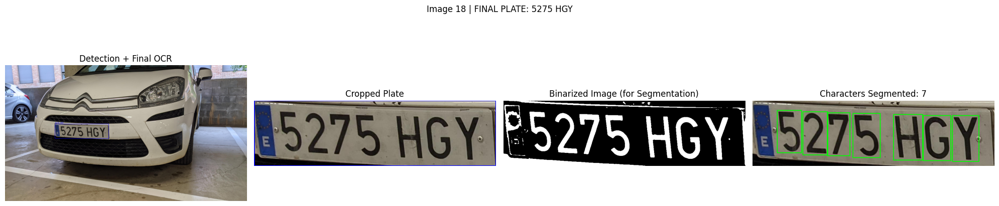

2 matrícules detectades. Només es processa la primera.

  Processant Imatge 19

 Matrícula 1: Bbox (337, 258, 453, 312)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 8954LVD (Score: 7, Conf: 0.83, Validació: 0.000)
  Resultat Fusionat (C): _______ (Score: 0, Validació: 0.000)

 OCR Resultat FINAL: 8954 LVD


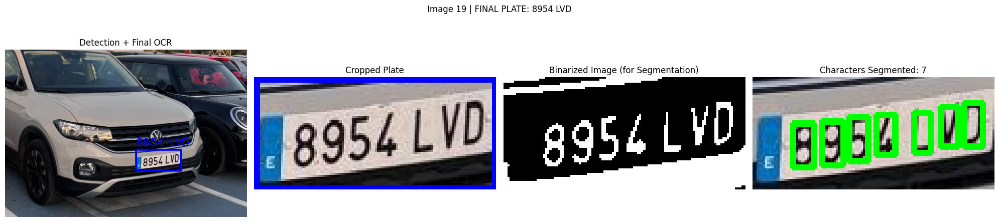


  Processant Imatge 20

 Matrícula 1: Bbox (1393, 849, 2214, 1100)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 4671FHC (Score: 7, Conf: 0.61, Validació: 0.776)
  Resultat Segmentat (B): 4674FHC (Score: 7, Conf: 0.88, Validació: 0.919)
 Seleccionat (B): Validació Creuada Alta (B=0.919) vs A=0.776.
  Resultat Fusionat (C): 4674FHC (Score: 7, Validació: 0.919)
 Fusió A+B (Mix): 4674FHC (Score: 7, Validació: 0.919)

 OCR Resultat FINAL: 4674 FHC


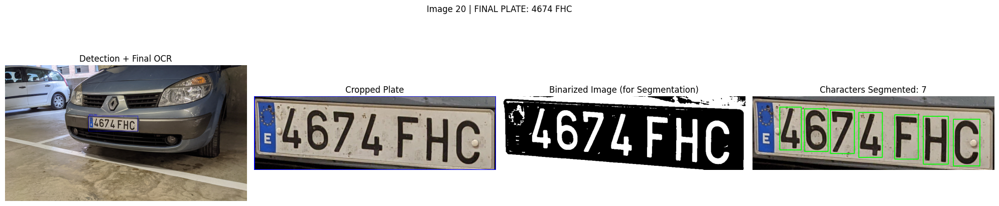


  Processant Imatge 21

 Matrícula 1: Bbox (451, 548, 815, 709)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 1258GBP (Score: 7, Conf: 1.00, Validació: 0.761)
  Resultat Fusionat (C): _258GBP (Score: 6, Validació: 0.761)

 OCR Resultat FINAL: 1258 GBP


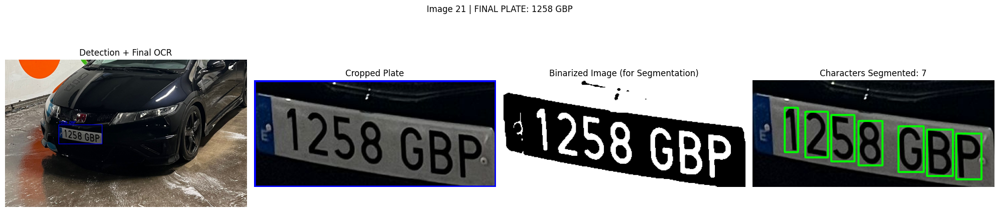


  Processant Imatge 22

 Matrícula 1: Bbox (883, 426, 1180, 593)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 1258GBP (Score: 7, Conf: 0.47, Validació: 0.954)
  Resultat Segmentat (B): 1258CPP (Score: 7, Conf: 0.50, Validació: 0.711)
 Mantingut (A).
  Resultat Fusionat (C): 1258GBP (Score: 7, Validació: 0.954)
 Fusió A+B (Mix): 1258GBP (Score: 7, Validació: 0.954)

 OCR Resultat FINAL: 1258 GBP


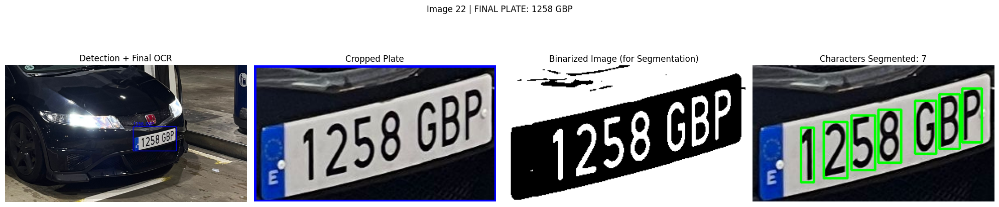


  Processant Imatge 23

 Matrícula 1: Bbox (662, 431, 814, 481)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 3522JXV (Score: 7, Conf: 0.56, Validació: 0.429)
  Resultat Segmentat (B): 3522JXV (Score: 7, Conf: 0.99, Validació: 0.429)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 35_2___ (Score: 3, Validació: 0.429)
 Fusió A+B (Mix): 3522JXV (Score: 7, Validació: 0.429)

 OCR Resultat FINAL: 3522 JXV


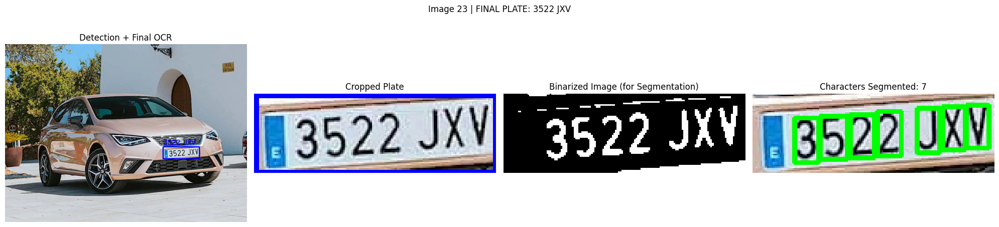


  Processant Imatge 24

 Matrícula 1: Bbox (276, 206, 613, 351)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 1258GBP (Score: 7, Conf: 0.90, Validació: 0.826)
  Resultat Segmentat (B): 1258GBP (Score: 7, Conf: 0.88, Validació: 0.826)
 Mantingut (A).
  Resultat Fusionat (C): _258GBP (Score: 6, Validació: 0.826)
 Fusió A+B (Mix): 1258GBP (Score: 7, Validació: 0.826)

 OCR Resultat FINAL: 1258 GBP


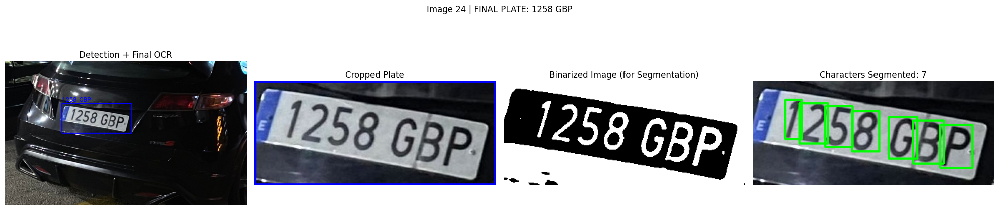


  Processant Imatge 25

 Matrícula 1: Bbox (390, 786, 916, 986)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 8733MKB (Score: 7, Conf: 0.60, Validació: 0.784)
  Resultat Segmentat (B): 8733MKB (Score: 7, Conf: 1.00, Validació: 0.784)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 8_33MKB (Score: 6, Validació: 0.784)
 Fusió A+B (Mix): 8733MKB (Score: 7, Validació: 0.784)

 OCR Resultat FINAL: 8733 MKB


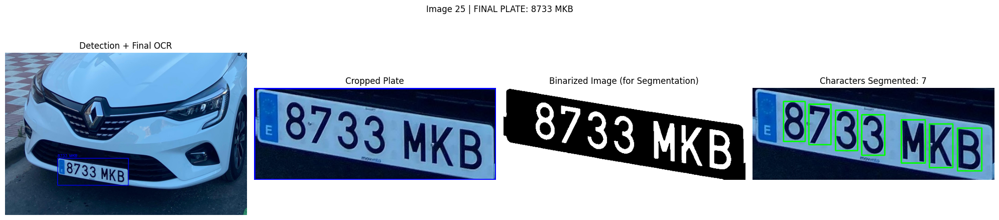


  Processant Imatge 26

 Matrícula 1: Bbox (647, 217, 861, 296)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 8958NBC (Score: 7, Conf: 0.83, Validació: 0.714)
  Resultat Fusionat (C): 8958N__ (Score: 5, Validació: 0.714)

 OCR Resultat FINAL: 8958 NBC


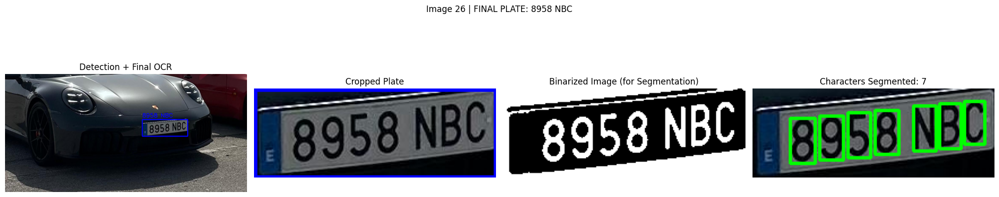


  Processant Imatge 27

 Matrícula 1: Bbox (290, 606, 558, 762)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 3384KHL (Score: 7, Conf: 0.89, Validació: 0.714)
  Resultat Segmentat (B): 3384KHL (Score: 7, Conf: 1.00, Validació: 0.714)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 3381KH_ (Score: 6, Validació: 0.843)
 Fusió A+B (Mix): 3384KHL (Score: 7, Validació: 0.714)

 OCR Resultat FINAL: 3384 KHL


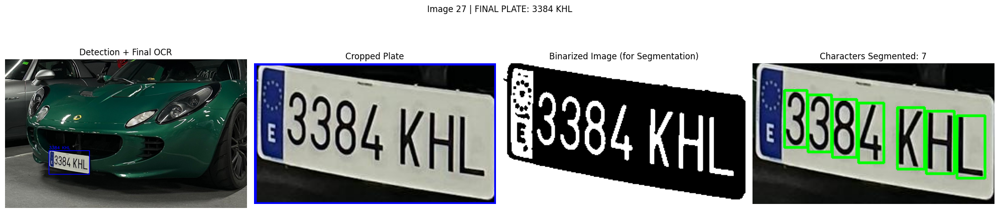


  Processant Imatge 28

 Matrícula 1: Bbox (786, 399, 1106, 566)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 1866LCH (Score: 7, Conf: 0.46, Validació: 0.232)
  Resultat Segmentat (B): 8861CHH (Score: 7, Conf: 0.69, Validació: 0.517)
 Seleccionat (B): Millor Validació Creuada (Desempat).
  Resultat Fusionat (C): 666_CHH (Score: 6, Validació: 0.794)
 Fusió A+B (Mix): 6866CHH (Score: 7, Validació: 0.655)
 Seleccionat (Mix A+B): Millor combinació validada.

 OCR Resultat FINAL: 6866 CHH


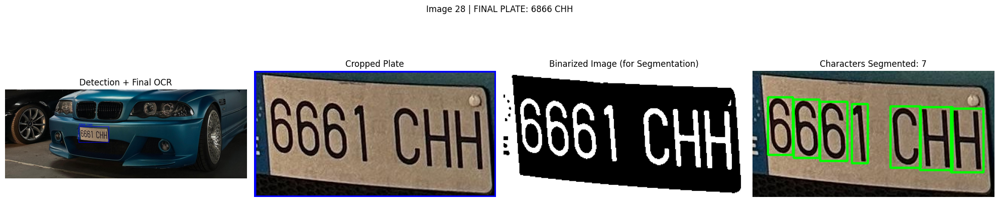


  Processant Imatge 29

 Matrícula 1: Bbox (1355, 569, 1651, 804)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 6200CVH (Score: 7, Conf: 0.98, Validació: 0.955)
  Resultat Segmentat (B): 6200CVH (Score: 7, Conf: 0.72, Validació: 0.955)
 Mantingut (A).
  Resultat Fusionat (C): 6200CVH (Score: 7, Validació: 0.955)
 Fusió A+B (Mix): 6200CVH (Score: 7, Validació: 0.955)

 OCR Resultat FINAL: 6200 CVH


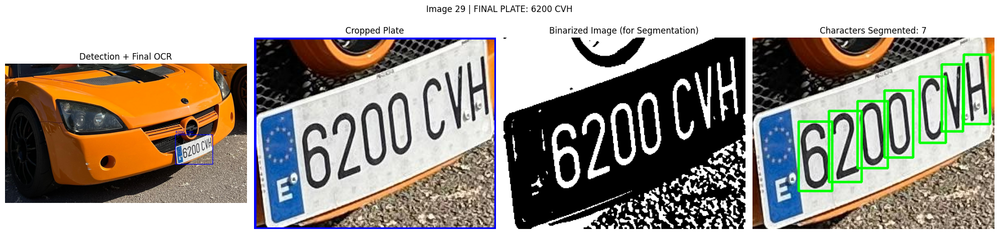


  Processant Imatge 30

 Matrícula 1: Bbox (736, 491, 1210, 643)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 0215JSG (Score: 7, Conf: 0.86, Validació: 0.785)
  Resultat Segmentat (B): 0215JSG (Score: 7, Conf: 0.99, Validació: 0.785)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 0215_SG (Score: 6, Validació: 0.785)
 Fusió A+B (Mix): 0215JSG (Score: 7, Validació: 0.785)

 OCR Resultat FINAL: 0215 JSG


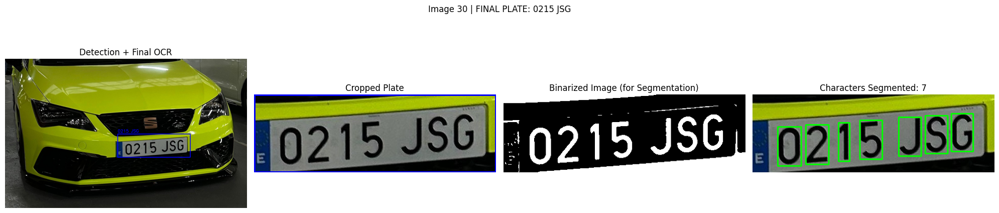


  Processant Imatge 31

 Matrícula 1: Bbox (1628, 696, 1966, 934)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 5119DLG (Score: 7, Conf: 0.62, Validació: 0.286)
  Resultat Segmentat (B): 5119LGC (Score: 7, Conf: 0.52, Validació: 0.527)
 Seleccionat (B): Millor Validació Creuada (Desempat).
  Resultat Fusionat (C): 5__9_GC (Score: 4, Validació: 0.527)
 Fusió A+B (Mix): 5119DGC (Score: 7, Validació: 0.527)

 OCR Resultat FINAL: 5119 LGC


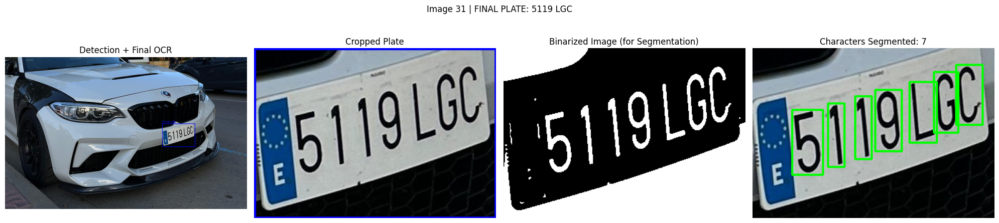


  Processant Imatge 32

 Matrícula 1: Bbox (1356, 533, 1590, 691)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 7314DHP (Score: 7, Conf: 0.42, Validació: 0.286)
  Resultat Segmentat (B): 7314DHP (Score: 7, Conf: 0.85, Validació: 0.286)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): _3_1_MP (Score: 4, Validació: 0.557)
 Fusió A+B (Mix): 7314DHP (Score: 7, Validació: 0.286)

 OCR Resultat FINAL: 7314 DHP


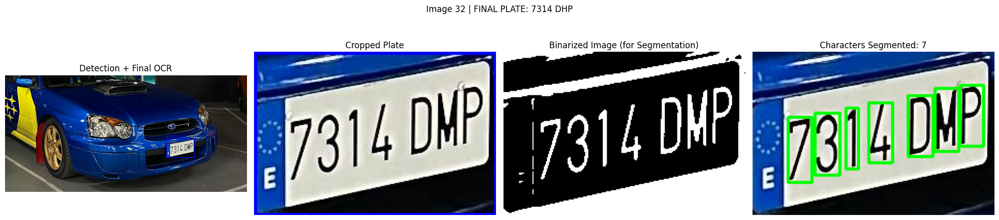


  Processant Imatge 33

 Matrícula 1: Bbox (1408, 449, 1793, 622)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 4971KKK (Score: 7, Conf: 0.76, Validació: 0.714)
  Resultat Segmentat (B): 4971KKK (Score: 7, Conf: 0.98, Validació: 0.714)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 49__KKK (Score: 5, Validació: 0.714)
 Fusió A+B (Mix): 4971KKK (Score: 7, Validació: 0.714)

 OCR Resultat FINAL: 4971 KKK


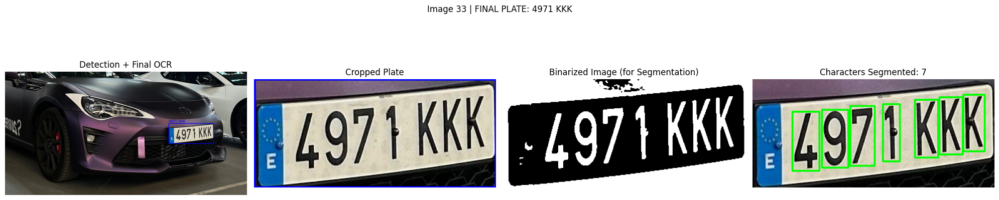


  Processant Imatge 34

 Matrícula 1: Bbox (343, 589, 524, 649)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 0580JXL (Score: 7, Conf: 0.72, Validació: 0.571)
  Resultat Segmentat (B): 0580JXL (Score: 7, Conf: 0.99, Validació: 0.571)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 0580___ (Score: 4, Validació: 0.571)
 Fusió A+B (Mix): 0580JXL (Score: 7, Validació: 0.571)

 OCR Resultat FINAL: 0580 JXL


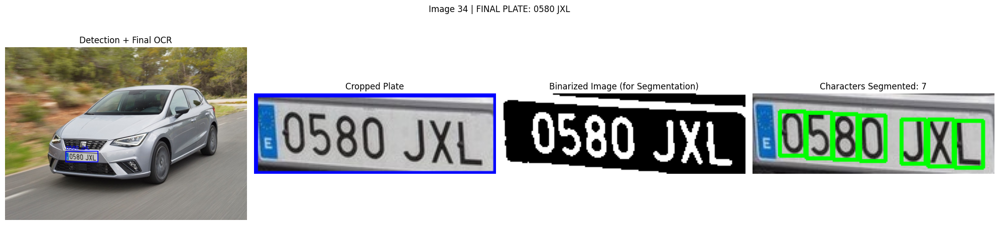


  Processant Imatge 35

 Matrícula 1: Bbox (1642, 519, 2070, 718)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 0360KDR (Score: 7, Conf: 0.49, Validació: 0.853)
  Resultat Segmentat (B): 0360KDR (Score: 7, Conf: 0.64, Validació: 0.853)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 0360KDR (Score: 7, Validació: 0.853)
 Fusió A+B (Mix): 0360KDR (Score: 7, Validació: 0.853)

 OCR Resultat FINAL: 0360 KDR


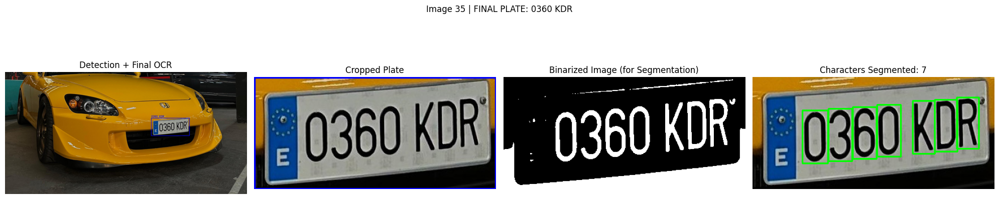


  Processant Imatge 36

 Matrícula 1: Bbox (1389, 927, 1999, 1199)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 2387KJW (Score: 7, Conf: 0.55, Validació: 0.602)
  Resultat Fusionat (C): 238_K_W (Score: 5, Validació: 0.602)

 OCR Resultat FINAL: 2387 KJW


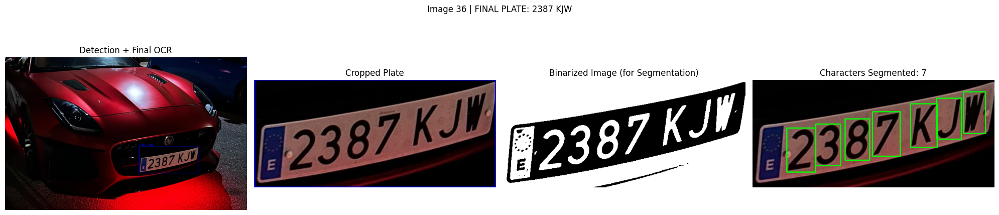


  Processant Imatge 37

 Matrícula 1: Bbox (1253, 767, 1593, 980)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 6834DMN (Score: 7, Conf: 0.71, Validació: 0.000)
  Resultat Segmentat (B): 8340MNS (Score: 7, Conf: 0.92, Validació: 0.793)
 Seleccionat (B): Validació Creuada Alta (B=0.793) vs A=0.000.
  Resultat Fusionat (C): 83_0MNS (Score: 6, Validació: 0.793)
 Fusió A+B (Mix): 8330MNS (Score: 7, Validació: 0.793)

 OCR Resultat FINAL: 8340 MNS


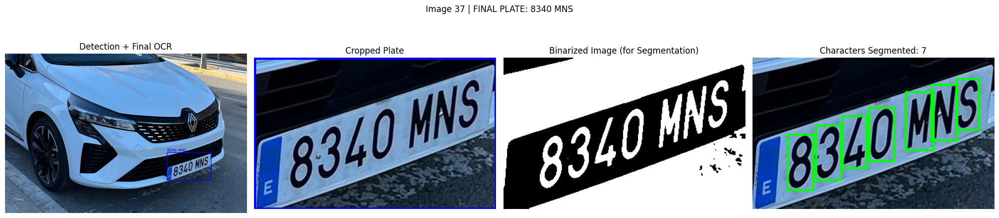


  Processant Imatge 38

 Matrícula 1: Bbox (172, 633, 609, 904)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 8577MPX (Score: 7, Conf: 0.83, Validació: 0.413)
  Resultat Segmentat (B): J577MPX (Score: 6, Conf: 0.58, Validació: 0.413)
  Resultat Fusionat (C): 35__MP_ (Score: 4, Validació: 0.482)
 Fusió A+B (Mix): 3577MPX (Score: 7, Validació: 0.482)
 Seleccionat (Mix A+B): Millor combinació validada.

 OCR Resultat FINAL: 3577 MPX


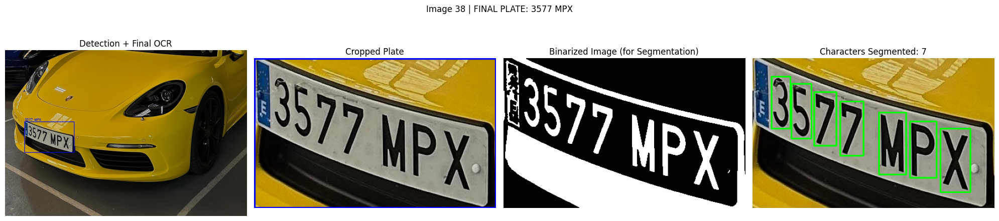


  Processant Imatge 39

 Matrícula 1: Bbox (110, 272, 289, 373)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 1988SMR (Score: 7, Conf: 0.44, Validació: 0.428)
  Resultat Segmentat (B): 1988MRK (Score: 7, Conf: 0.57, Validació: 0.857)
 Seleccionat (B): Validació Creuada Alta (B=0.857) vs A=0.428.
  Resultat Fusionat (C): _988MRK (Score: 6, Validació: 0.857)
 Fusió A+B (Mix): 1988MRK (Score: 7, Validació: 0.857)

 OCR Resultat FINAL: 1988 MRK


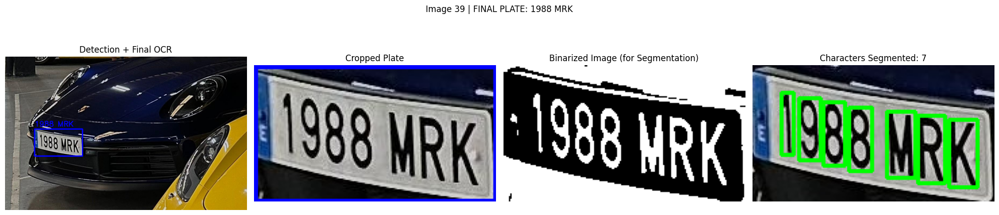


  Processant Imatge 40

 Matrícula 1: Bbox (353, 715, 740, 957)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 5599KGS (Score: 7, Conf: 0.68, Validació: 0.757)
  Resultat Segmentat (B): 5599KGS (Score: 7, Conf: 0.97, Validació: 0.757)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 5599KGS (Score: 7, Validació: 0.757)
 Fusió A+B (Mix): 5599KGS (Score: 7, Validació: 0.757)

 OCR Resultat FINAL: 5599 KGS


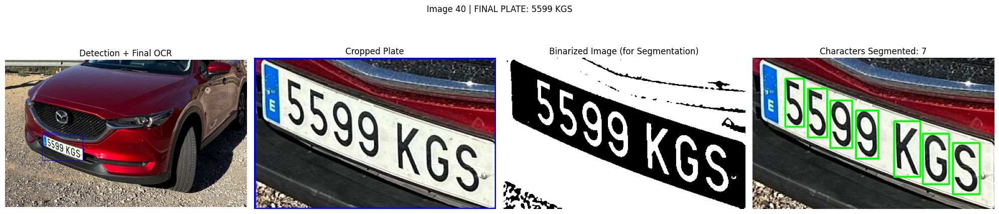


  Processant Imatge 41

 Matrícula 1: Bbox (972, 304, 1289, 423)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 2994GXT (Score: 7, Conf: 0.93, Validació: 0.608)
  Resultat Segmentat (B): 2994GXT (Score: 7, Conf: 0.88, Validació: 0.608)
 Mantingut (A).
  Resultat Fusionat (C): 2991G_T (Score: 6, Validació: 0.736)
 Fusió A+B (Mix): 2994GXT (Score: 7, Validació: 0.608)

 OCR Resultat FINAL: 2994 GXT


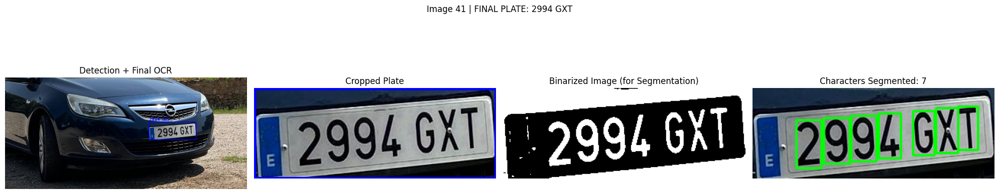


  Processant Imatge 42

 Matrícula 1: Bbox (334, 497, 691, 658)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 5511LMY (Score: 7, Conf: 0.99, Validació: 0.713)
  Resultat Fusionat (C): 55__LMY (Score: 5, Validació: 0.713)

 OCR Resultat FINAL: 5511 LMY


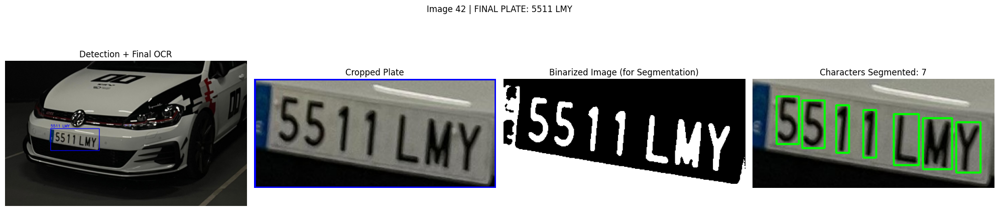


  Processant Imatge 43

 Matrícula 1: Bbox (473, 1393, 917, 1761)
Segmentació final: 7 caràcters
 No s'ha obtingut resultat vàlid de la lectura completa (A).
  Resultat Fusionat (C): 082_G__ (Score: 4, Validació: 0.396)
 Seleccionat (C): Millor Fusionat/Validació Confiança.

 OCR Resultat FINAL: 082_ G__


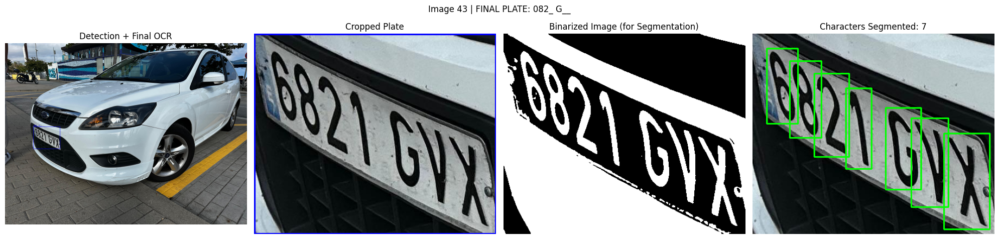


  Processant Imatge 44

 Matrícula 1: Bbox (2371, 1477, 3153, 1933)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 6019LGN (Score: 7, Conf: 0.71, Validació: 0.000)
  Resultat Segmentat (B): 0191GNL (Score: 7, Conf: 0.85, Validació: 0.556)
 Seleccionat (B): Validació Creuada Alta (B=0.556) vs A=0.000.
  Resultat Fusionat (C): 0_9_GN_ (Score: 4, Validació: 0.556)
 Fusió A+B (Mix): 0099GNN (Score: 7, Validació: 0.556)

 OCR Resultat FINAL: 0191 GNL


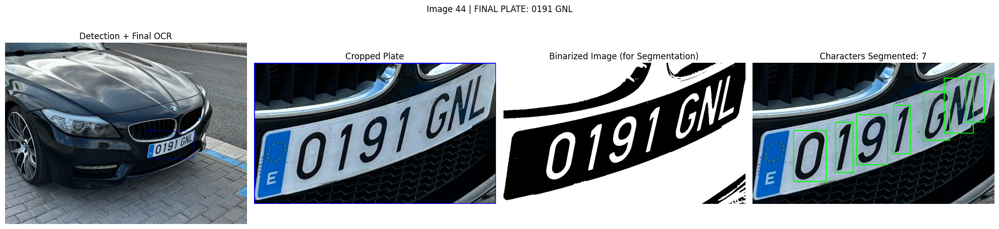


  Processant Imatge 45

 Matrícula 1: Bbox (291, 258, 386, 283)
Només 4 caràcters trobats. Provant projecció horitzontal...
Segmentació final: 4 caràcters
  Resultat Placa Sencera (A): 3676JRD (Score: 7, Conf: 1.00, Validació: -1.000)

 OCR Resultat FINAL: 3676 JRD


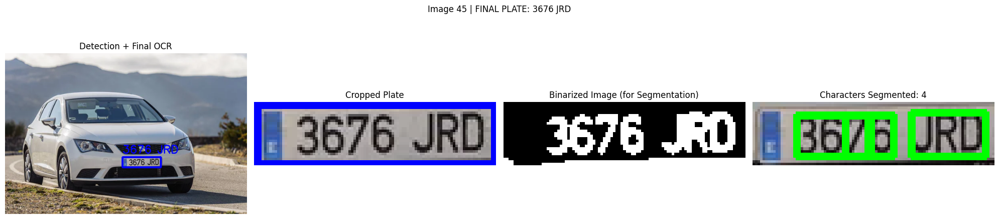


  Processant Imatge 46

 Matrícula 1: Bbox (1933, 1139, 2657, 1527)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 2889KXK (Score: 7, Conf: 0.72, Validació: 0.857)
  Resultat Segmentat (B): 2889KXK (Score: 7, Conf: 0.98, Validació: 0.857)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 2889K_K (Score: 6, Validació: 0.857)
 Fusió A+B (Mix): 2889KXK (Score: 7, Validació: 0.857)

 OCR Resultat FINAL: 2889 KXK


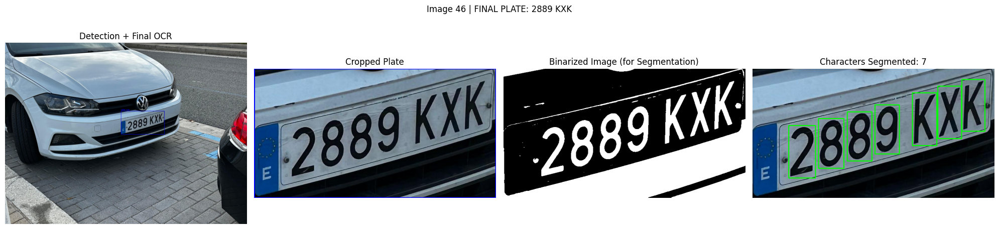


  Processant Imatge 47

 Matrícula 1: Bbox (774, 704, 1221, 822)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 3245LCX (Score: 7, Conf: 0.99, Validació: 0.560)
  Resultat Segmentat (B): 3245LCX (Score: 7, Conf: 0.94, Validació: 0.560)
 Mantingut (A).
  Resultat Fusionat (C): 32_5_C_ (Score: 4, Validació: 0.560)
 Fusió A+B (Mix): 3245LCX (Score: 7, Validació: 0.560)

 OCR Resultat FINAL: 3245 LCX


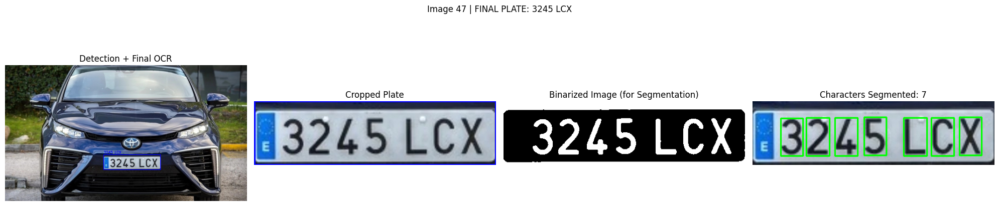


  Processant Imatge 48

 Matrícula 1: Bbox (356, 301, 533, 350)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 1999BZZ (Score: 7, Conf: 0.83, Validació: 0.280)
  Resultat Segmentat (B): 99987Z7 (Score: 5, Conf: 0.62, Validació: 0.402)
  Resultat Fusionat (C): 999____ (Score: 3, Validació: 0.402)
 Fusió A+B (Mix): 9999BZZ (Score: 7, Validació: 0.402)
 Seleccionat (Mix A+B): Millor combinació validada.

 OCR Resultat FINAL: 9999 BZZ


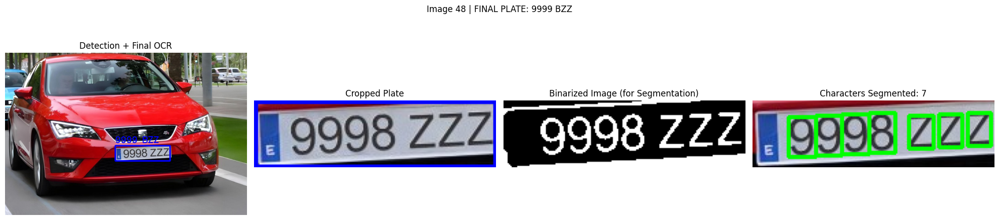


  Processant Imatge 49

 Matrícula 1: Bbox (60, 487, 362, 669)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 1368DRH (Score: 7, Conf: 0.86, Validació: 0.571)
  Resultat Segmentat (B): 1368DRH (Score: 7, Conf: 0.91, Validació: 0.571)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): _368_R_ (Score: 4, Validació: 0.571)
 Fusió A+B (Mix): 1368DRH (Score: 7, Validació: 0.571)

 OCR Resultat FINAL: 1368 DRH


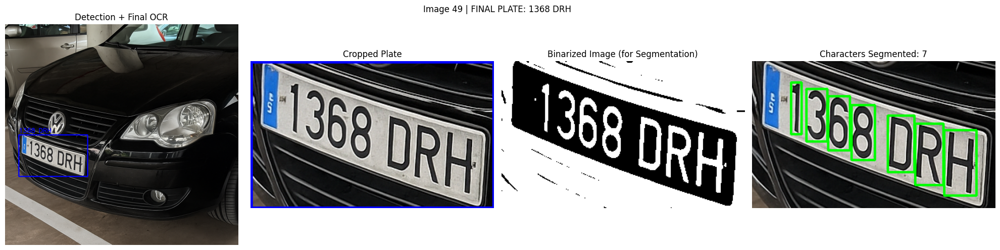


  Processant Imatge 50

 Matrícula 1: Bbox (738, 492, 1363, 765)
Segmentació final: 7 caràcters
  Resultat Placa Sencera (A): 0958KCJ (Score: 7, Conf: 0.71, Validació: 0.999)
  Resultat Segmentat (B): 0958KCJ (Score: 7, Conf: 0.97, Validació: 0.999)
 Seleccionat (B): Millor Confiança Bruta (Doble Desempat).
  Resultat Fusionat (C): 0958KCJ (Score: 7, Validació: 0.999)
 Fusió A+B (Mix): 0958KCJ (Score: 7, Validació: 0.999)

 OCR Resultat FINAL: 0958 KCJ


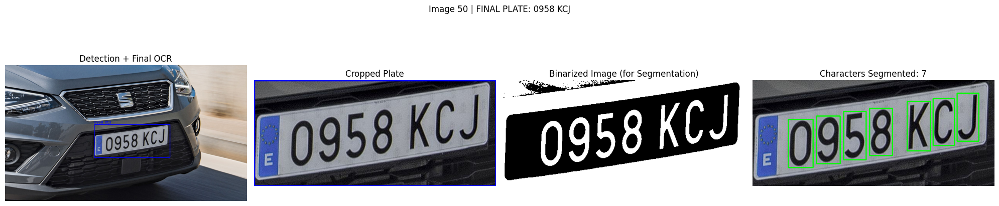

In [46]:
# Segmentation and display of characters

detector.process_and_show_results(prediction_results, reader)

In [47]:
# Carreguem el Ground Truth
with open('ground_truth.json', 'r') as f:
    ground_truth = json.load(f)

print(f"S'han carregat {len(ground_truth)} transcripcions del Ground Truth.")

S'han carregat 50 transcripcions del Ground Truth.


In [48]:
def run_and_collect_results(image_path, detector, reader):
    """
    Executa tot el pipeline sobre una imatge i retorna un diccionari amb els resultats clau.
    """
    results = {
        'image_name': os.path.basename(image_path),
        'plate_detected': False,
        'num_characters_segmented': 0,
        'predicted_plate': None
    }
    
    # 1. Detecció
    try:
        # Utilitza 'verbose=False' per minimitzar la sortida de YOLO
        prediction = detector.model.predict(source=image_path, save=False, conf=0.25, verbose=False) 
        if len(prediction) == 0 or len(prediction[0].boxes) == 0:
            return results # No s'ha detectat res
    except Exception as e:
        print(f"Error en la detecció de {results['image_name']}: {e}")
        return results

    results['plate_detected'] = True
    
    # Agafem la primera detecció
    box = prediction[0].boxes[0]
    x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
    image = prediction[0].orig_img
    plate_image = image[y1:y2, x1:x2]
    
    if plate_image.size == 0:
        return results # Error en retallar

    # 2. Segmentació
    # NOTA: Cal assegurar-se que detector.segment_characters no faci prints amb caràcters Unicode
    # que causin errors, si és necessari, modifica el mètode internament.
    characters, _ = detector.segment_characters(plate_image)
    results['num_characters_segmented'] = len(characters)
    
    # 3. Reconeixement (la lògica de fusió i selecció es manté)
    
    # (A) OCR Placa Sencera
    ocr_raw_full = reader.readtext(plate_image, detail=1, paragraph=False, allowlist=CHAR_CLASSES)
    sorted_ocr_full = sorted(ocr_raw_full, key=lambda item: item[0][0][0]) if ocr_raw_full else []
    plate_text_raw = "".join([item[1] for item in sorted_ocr_full]).replace(" ", "").upper()
    filtered_full = "".join([c for c in plate_text_raw if c in CHAR_CLASSES])
    if filtered_full.startswith("E"): filtered_full = filtered_full[1:]
    best_plate_full, score_full = detector.find_best_7_char_segment(filtered_full)
    
    final_plate_text = best_plate_full if score_full > -1 else "ERROR"
    max_score = score_full
    
    # Validació Creuada
    individual_results = []
    if len(characters) == 7:
        # Cal assegurar-se que _ocr_individual_characters no faci prints.
        individual_results = detector.ocr_individual_characters(characters, reader) 
    
    val_conf_A = detector.validate_with_individual_conf(best_plate_full, individual_results) if best_plate_full and individual_results else -1.0
    max_val_conf = val_conf_A

    # (B) OCR Segmentada
    corrected_segment_text = ""
    if len(characters) == 7:
        # Cal assegurar-se que _ocr_segmented_characters_with_conf no faci prints.
        segmented_text, conf_segment = detector.ocr_segmented_characters_with_conf(characters, reader)
        if len(segmented_text) == 7:
            corrected_segment_text = detector.apply_final_correction(segmented_text)
            score_segment = detector.calculate_format_score(corrected_segment_text)
            val_conf_B = detector.validate_with_individual_conf(corrected_segment_text, individual_results)
            
            # Lògica de selecció B vs A
            if score_segment > max_score or \
               (max_score == 7 and score_segment >= 6 and val_conf_B > val_conf_A and val_conf_B >= 0.55) or \
               (score_segment == max_score and val_conf_B > max_val_conf):
                final_plate_text = corrected_segment_text
                max_score = score_segment
                max_val_conf = val_conf_B

    # (C) Fusionat Individual
    corrected_fusion_text = ""
    if individual_results:
        corrected_fusion_text, score_fusion, val_conf_fusion = detector.build_plate_from_individual_ocr(individual_results)
        if score_fusion > max_score or (score_fusion == max_score and val_conf_fusion > max_val_conf):
            final_plate_text = corrected_fusion_text
            max_score = score_fusion
            max_val_conf = val_conf_fusion
    
    # (D) Mix A+B
    if best_plate_full and corrected_segment_text:
        mixed_plate, _ = detector.mix_plates_by_position(best_plate_full, corrected_segment_text, individual_results, corrected_fusion_text)
        mixed_score = detector.calculate_format_score(mixed_plate)
        val_conf_mix = detector.validate_with_individual_conf(mixed_plate, individual_results)
        if mixed_score > max_score or (mixed_score == max_score and val_conf_mix > max_val_conf):
            final_plate_text = mixed_plate
            
    results['predicted_plate'] = final_plate_text if final_plate_text != "ERROR" else None

    return results


all_results = []
for image_name in tqdm(ground_truth.keys(), desc="Processant imatges"):
    image_path = os.path.join(test_dir, image_name)
    if os.path.exists(image_path):
        # S'eliminen les línies de redirecció de sys.stdout.
        
        # Assegura't que les funcions cridades internament (com segment_characters)
        # no tenen cap print() que pugui causar problemes.
        result = run_and_collect_results(image_path, detector, reader)
        
        result['ground_truth'] = ground_truth[image_name]
        all_results.append(result)
    else:
        print(f" Atenció: La imatge {image_name} no es troba a la carpeta de test.")

# Convertim els resultats a un DataFrame de Pandas
df_results = pd.DataFrame(all_results)
print("\nMostra dels resultats recollits:")
print(df_results.head()) # Utilitzem print() normal, ja que hem eliminat la redirecció

# --- Guardar el DataFrame a CSV ---
output_csv_path = 'ocr_evaluation_results.csv'
df_results.to_csv(output_csv_path, index=False, encoding='utf-8')
print(f"\n Resultats guardats a: {output_csv_path}")

Processant imatges:   0%|          | 0/50 [00:00<?, ?it/s]

Segmentació final: 7 caràcters


Processant imatges:   2%|▏         | 1/50 [00:02<02:01,  2.47s/it]

Segmentació final: 6 caràcters


Processant imatges:   4%|▍         | 2/50 [00:02<01:01,  1.29s/it]

Segmentació final: 7 caràcters


Processant imatges:   6%|▌         | 3/50 [00:06<01:45,  2.25s/it]

Segmentació final: 7 caràcters


Processant imatges:   8%|▊         | 4/50 [00:08<01:33,  2.03s/it]

Només 4 caràcters trobats. Provant projecció horitzontal...
Segmentació final: 4 caràcters


Processant imatges:  10%|█         | 5/50 [00:10<01:33,  2.09s/it]

Segmentació final: 7 caràcters


Processant imatges:  12%|█▏        | 6/50 [00:13<01:49,  2.48s/it]

Segmentació final: 7 caràcters


Processant imatges:  14%|█▍        | 7/50 [00:17<02:06,  2.95s/it]

Segmentació final: 7 caràcters


Processant imatges:  16%|█▌        | 8/50 [00:26<03:20,  4.78s/it]

Segmentació final: 7 caràcters


Processant imatges:  18%|█▊        | 9/50 [00:36<04:29,  6.58s/it]

Segmentació final: 7 caràcters


Processant imatges:  20%|██        | 10/50 [00:43<04:24,  6.62s/it]

Segmentació final: 7 caràcters


Processant imatges:  22%|██▏       | 11/50 [00:49<04:08,  6.37s/it]

Segmentació final: 7 caràcters


Processant imatges:  24%|██▍       | 12/50 [00:57<04:28,  7.06s/it]

Segmentació final: 7 caràcters


Processant imatges:  26%|██▌       | 13/50 [01:04<04:12,  6.82s/it]

Segmentació final: 7 caràcters


Processant imatges:  28%|██▊       | 14/50 [01:10<03:57,  6.59s/it]

Segmentació final: 7 caràcters


Processant imatges:  30%|███       | 15/50 [01:17<03:57,  6.78s/it]

Segmentació final: 7 caràcters


Processant imatges:  32%|███▏      | 16/50 [01:24<03:57,  7.00s/it]

Segmentació final: 7 caràcters


Processant imatges:  34%|███▍      | 17/50 [01:32<03:58,  7.23s/it]

Segmentació final: 7 caràcters


Processant imatges:  36%|███▌      | 18/50 [01:39<03:52,  7.27s/it]

Segmentació final: 7 caràcters


Processant imatges:  38%|███▊      | 19/50 [01:48<03:57,  7.65s/it]

Segmentació final: 7 caràcters


Processant imatges:  40%|████      | 20/50 [01:54<03:35,  7.18s/it]

Segmentació final: 7 caràcters


Processant imatges:  42%|████▏     | 21/50 [02:01<03:28,  7.18s/it]

Segmentació final: 7 caràcters


Processant imatges:  44%|████▍     | 22/50 [02:09<03:25,  7.33s/it]

Segmentació final: 7 caràcters


Processant imatges:  46%|████▌     | 23/50 [02:15<03:11,  7.08s/it]

Segmentació final: 7 caràcters


Processant imatges:  48%|████▊     | 24/50 [02:20<02:46,  6.39s/it]

Segmentació final: 7 caràcters


Processant imatges:  50%|█████     | 25/50 [02:25<02:24,  5.78s/it]

Segmentació final: 7 caràcters


Processant imatges:  52%|█████▏    | 26/50 [02:26<01:47,  4.46s/it]

Segmentació final: 7 caràcters


Processant imatges:  54%|█████▍    | 27/50 [02:31<01:43,  4.50s/it]

Segmentació final: 7 caràcters


Processant imatges:  56%|█████▌    | 28/50 [02:33<01:27,  3.97s/it]

Segmentació final: 7 caràcters


Processant imatges:  58%|█████▊    | 29/50 [02:36<01:15,  3.62s/it]

Segmentació final: 7 caràcters


Processant imatges:  60%|██████    | 30/50 [02:39<01:06,  3.31s/it]

Segmentació final: 7 caràcters


Processant imatges:  62%|██████▏   | 31/50 [02:42<01:03,  3.34s/it]

Segmentació final: 7 caràcters


Processant imatges:  64%|██████▍   | 32/50 [02:45<00:56,  3.16s/it]

Segmentació final: 7 caràcters


Processant imatges:  66%|██████▌   | 33/50 [02:47<00:46,  2.75s/it]

Segmentació final: 7 caràcters


Processant imatges:  68%|██████▊   | 34/50 [02:49<00:42,  2.67s/it]

Segmentació final: 7 caràcters


Processant imatges:  70%|███████   | 35/50 [02:52<00:42,  2.86s/it]

Segmentació final: 7 caràcters


Processant imatges:  72%|███████▏  | 36/50 [02:55<00:39,  2.80s/it]

Segmentació final: 7 caràcters


Processant imatges:  74%|███████▍  | 37/50 [02:58<00:35,  2.74s/it]

Segmentació final: 7 caràcters


Processant imatges:  76%|███████▌  | 38/50 [02:59<00:29,  2.44s/it]

Segmentació final: 7 caràcters


Processant imatges:  78%|███████▊  | 39/50 [03:04<00:32,  2.98s/it]

Segmentació final: 7 caràcters


Processant imatges:  80%|████████  | 40/50 [03:06<00:28,  2.86s/it]

Segmentació final: 7 caràcters


Processant imatges:  82%|████████▏ | 41/50 [03:11<00:31,  3.53s/it]

Segmentació final: 7 caràcters


Processant imatges:  84%|████████▍ | 42/50 [03:13<00:24,  3.11s/it]

Segmentació final: 7 caràcters


Processant imatges:  86%|████████▌ | 43/50 [03:18<00:25,  3.67s/it]

Segmentació final: 7 caràcters


Processant imatges:  88%|████████▊ | 44/50 [03:20<00:17,  2.95s/it]

Segmentació final: 7 caràcters


Processant imatges:  90%|█████████ | 45/50 [03:22<00:14,  2.86s/it]

Segmentació final: 7 caràcters


Processant imatges:  92%|█████████▏| 46/50 [03:25<00:10,  2.69s/it]

Segmentació final: 7 caràcters


Processant imatges:  94%|█████████▍| 47/50 [03:27<00:08,  2.71s/it]

Segmentació final: 7 caràcters


Processant imatges:  96%|█████████▌| 48/50 [03:30<00:05,  2.79s/it]

Segmentació final: 7 caràcters


Processant imatges:  98%|█████████▊| 49/50 [03:34<00:02,  2.98s/it]

Segmentació final: 7 caràcters


Processant imatges: 100%|██████████| 50/50 [03:38<00:00,  4.38s/it]



Mostra dels resultats recollits:
  image_name  plate_detected  num_characters_segmented predicted_plate  \
0      1.jpg            True                         7         0478LFR   
1      2.jpg            True                         6         8440NSH   
2      3.jpg            True                         7         3522JXV   
3      4.jpg            True                         7         0580JXL   
4      5.jpg            True                         4         3676JRD   

  ground_truth  
0      0478LFR  
1      5440NSA  
2      3522JXV  
3      0580JXL  
4      3676JRD  

 Resultats guardats a: ocr_evaluation_results.csv


--- Resultats de Localització ---
Total d'imatges analitzades: 50
Matrícules detectades correctament: 50
Taxa de Detecció (Detection Rate): 100.00%


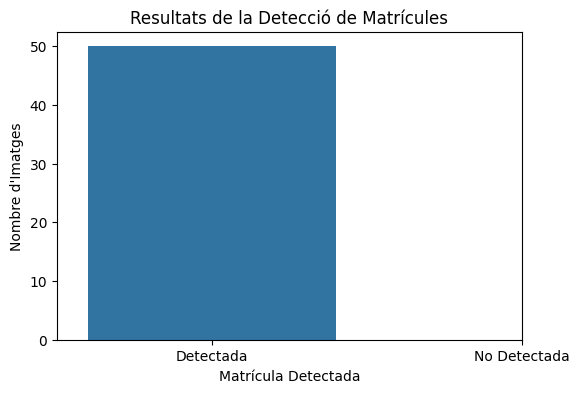

In [49]:
total_images = len(df_results)
plates_detected = df_results['plate_detected'].sum()
detection_rate = (plates_detected / total_images) * 100

print("--- Resultats de Localització ---")
print(f"Total d'imatges analitzades: {total_images}")
print(f"Matrícules detectades correctament: {plates_detected}")
print(f"Taxa de Detecció (Detection Rate): {detection_rate:.2f}%")

# Gràfic de barres per visualitzar el resultat
plt.figure(figsize=(6, 4))
sns.countplot(x='plate_detected', data=df_results)
plt.title('Resultats de la Detecció de Matrícules')
plt.xlabel('Matrícula Detectada')
plt.ylabel('Nombre d\'Imatges')
plt.xticks([1, 0], ['No Detectada', 'Detectada'])
plt.show()

--- Resultats de Segmentació (només sobre matrícules detectades) ---
Total de matrícules detectades: 50
Segmentacions perfectes (7 caràcters): 48
Taxa de Segmentació Perfecta: 96.00%


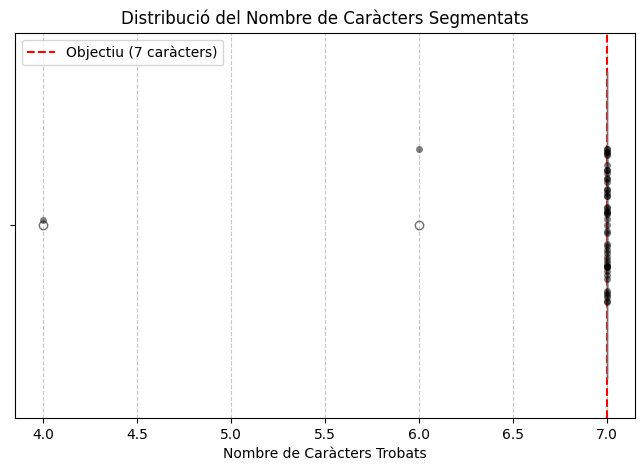

In [50]:
df_detected = df_results[df_results['plate_detected'] == True].copy()

perfect_segmentation = (df_detected['num_characters_segmented'] == 7).sum()
total_detected = len(df_detected)
perfect_segmentation_rate = (perfect_segmentation / total_detected) * 100

print("--- Resultats de Segmentació (només sobre matrícules detectades) ---")
print(f"Total de matrícules detectades: {total_detected}")
print(f"Segmentacions perfectes (7 caràcters): {perfect_segmentation}")
print(f"Taxa de Segmentació Perfecta: {perfect_segmentation_rate:.2f}%")

# Boxplot per a la distribució
plt.figure(figsize=(8, 5))
sns.boxplot(x='num_characters_segmented', data=df_detected, color='skyblue')
sns.stripplot(x='num_characters_segmented', data=df_detected, color='black', alpha=0.5, jitter=0.2)
plt.title('Distribució del Nombre de Caràcters Segmentats')
plt.xlabel('Nombre de Caràcters Trobats')
plt.ylabel('')
plt.axvline(x=7, color='red', linestyle='--', label='Objectiu (7 caràcters)')
plt.legend()
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

--- Resultats de Reconeixement OCR ---
Total de matrícules avaluades per OCR: 50
Matrícules reconegudes perfectament: 42
 Exactitud (Accuracy): 84.00%
 Word Error Rate (WER): 16.00%
 Character Error Rate (CER): 4.29%


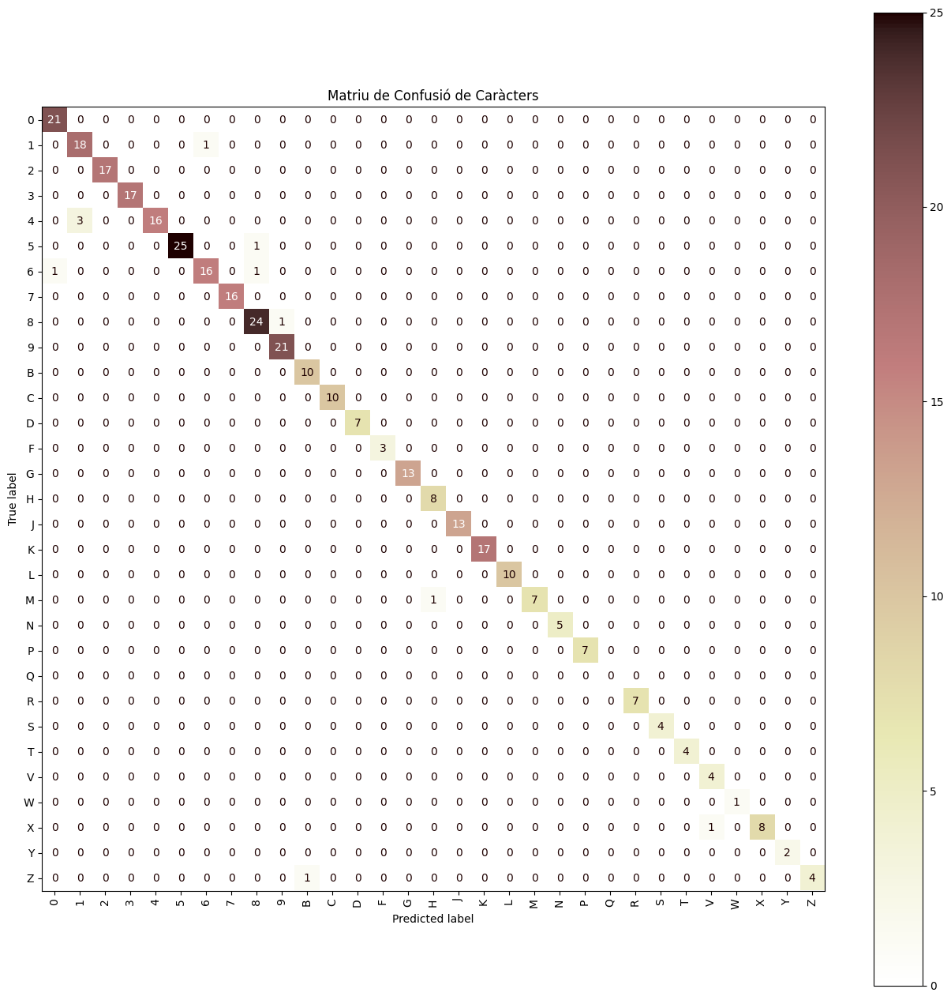

In [51]:
df_ocr = df_detected.dropna(subset=['predicted_plate']).copy()

total_ocr_evaluations = len(df_ocr)
exact_matches = (df_ocr['predicted_plate'] == df_ocr['ground_truth']).sum()

# Càlcul de WER
wer = (1 - (exact_matches / total_ocr_evaluations)) * 100

# Càlcul de CER
df_ocr['levenshtein_distance'] = df_ocr.apply(
    lambda row: Levenshtein.distance(str(row['predicted_plate']), str(row['ground_truth'])), 
    axis=1
)
total_levenshtein_distance = df_ocr['levenshtein_distance'].sum()
total_characters_ground_truth = df_ocr['ground_truth'].str.len().sum()
cer = (total_levenshtein_distance / total_characters_ground_truth) * 100

print("--- Resultats de Reconeixement OCR ---")
print(f"Total de matrícules avaluades per OCR: {total_ocr_evaluations}")
print(f"Matrícules reconegudes perfectament: {exact_matches}")
print(f" Exactitud (Accuracy): {100 - wer:.2f}%")
print(f" Word Error Rate (WER): {wer:.2f}%")
print(f" Character Error Rate (CER): {cer:.2f}%")

y_true = []
y_pred = []

df_len_match = df_ocr[df_ocr['predicted_plate'].str.len() == 7].copy()

for index, row in df_len_match.iterrows():
    true_plate = row['ground_truth']
    pred_plate = row['predicted_plate']
    for i in range(7):
        y_true.append(true_plate[i])
        y_pred.append(pred_plate[i])

# Creació de la matriu de confusió
cm = confusion_matrix(y_true, y_pred, labels=list(CHAR_CLASSES))

# Visualització
fig, ax = plt.subplots(figsize=(16, 16))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=list(CHAR_CLASSES))
disp.plot(ax=ax, cmap='pink_r', xticks_rotation='vertical')
plt.title('Matriu de Confusió de Caràcters')
plt.show()